<a href="https://colab.research.google.com/github/Fadora/diplomatervezes2024/blob/main/mri_segmentation_training.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Szükséges importok & token**

In [ ]:
!pip install -q kaggle
!pip install mat73

import os
import numpy as np
from PIL import Image
from mat73 import loadmat
import matplotlib.pyplot as plt
import cv2
import h5py
from skimage.transform import resize
from google.colab import files
import random


import zipfile
from torchvision import transforms
import torch
from torch.utils.data import Dataset, DataLoader

from sklearn.metrics import precision_recall_curve, auc

import torch.nn as nn
import torch.optim as optim

In [ ]:

files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"drafbin","key":"996fb26f38991862b6f5042a92223973"}'}

# **Adatbázis letöltés**

In [ ]:
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

!kaggle datasets download -d ashkhagan/figshare-brain-tumor-dataset
!unzip figshare-brain-tumor-dataset.zip

Dataset URL: https://www.kaggle.com/datasets/ashkhagan/figshare-brain-tumor-dataset
License(s): CC-BY-SA-4.0
100% 835M/839M [00:12<00:00, 104MB/s]
100% 839M/839M [00:12<00:00, 68.6MB/s]
Archive:  figshare-brain-tumor-dataset.zip
  inflating: dataset/README.txt      
  inflating: dataset/cvind.mat       
  inflating: dataset/data/1.mat      
  inflating: dataset/data/10.mat     
  inflating: dataset/data/100.mat    
  inflating: dataset/data/1000.mat   
  inflating: dataset/data/1001.mat   
  inflating: dataset/data/1002.mat   
  inflating: dataset/data/1003.mat   
  inflating: dataset/data/1004.mat   
  inflating: dataset/data/1005.mat   
  inflating: dataset/data/1006.mat   
  inflating: dataset/data/1007.mat   
  inflating: dataset/data/1008.mat   
  inflating: dataset/data/1009.mat   
  inflating: dataset/data/101.mat    
  inflating: dataset/data/1010.mat   
  inflating: dataset/data/1011.mat   
  inflating: dataset/data/1012.mat   
  inflating: dataset/data/1013.mat   
  inflating

In [ ]:

# Path to the zip file
zip_file_path = '/content/figshare-brain-tumor-dataset.zip'

# Initialize an empty list to store .mat files
mat_files_list = []

# Open the zip file
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    # Iterate through each file in the zip folder
    for file_info in zip_ref.infolist():
        # Check if the file has a .mat extension
        if file_info.filename.endswith('.mat'):
           if not file_info.filename.startswith('dataset/cvind'):
            # Add the file name to the list
            mat_files_list.append(file_info.filename)

# Print the list of .mat files
#print("List of .mat files:")
#for file_name in mat_files_list:
 #   print(file_name)

# **GLIOMA fájlok kigyűjtése és megjelenítése**


In [ ]:
mat_files_meningioma = [] # 1
mat_files_gliomas = []    # 2 ez kell nekünk alapból
mat_files_pituitary = []  # 3

for i in range(1,len(mat_files_list)+1):
    path = f"dataset/data/{i}.mat"
    data=loadmat(path)
    img=data['cjdata']
    label=img['label']
    if label == 2.0:
      mat_files_gliomas.append(data)

In [ ]:
# Lista randomizálása, hogy biztosan ne legyen semmiféle rendszer a sorrendben
random.shuffle(mat_files_gliomas)

## **Maszkok kigyűjtése**

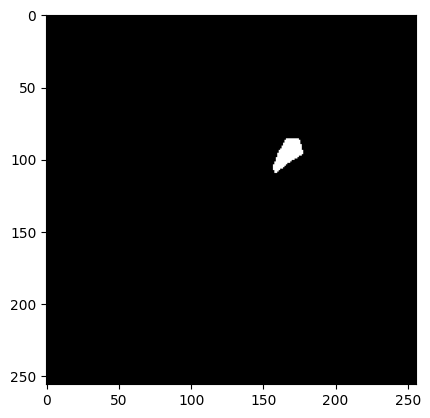

In [ ]:
masks = []
len(mat_files_gliomas)
for i in range(len(mat_files_gliomas)):
  mask = mat_files_gliomas[i]["cjdata"]["tumorMask"][()]
  mask = np.expand_dims(resize(mask, (256, 256), mode="constant", preserve_range=True), axis=-1)
  masks.append(mask)

plt.imshow(masks[0], cmap='gray')
#masks=np.array(masks)  inkább később, hogy még displayelhető legyen

## **Képek kigyűjtése**

(256, 256, 1)


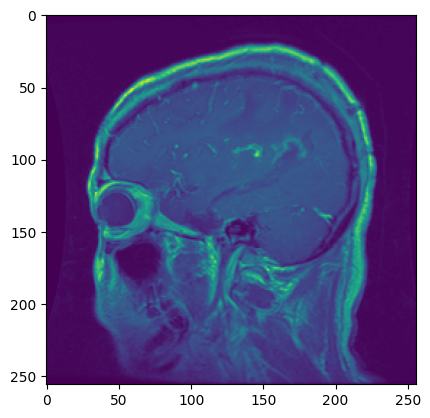

In [ ]:
images = []
for i in range(len(mat_files_gliomas)):
  im = mat_files_gliomas[i]["cjdata"]["image"][()]
  im = np.expand_dims(resize(im, (256, 256), mode="constant", preserve_range=True), axis=-1)
  images.append(im)

plt.imshow(images[0])
print(images[0].shape)

raw_images = images

Eddig megvannak a képek és a maszkok külön, displayelhető formátumban.
A következőkben ezek átalakítása következik, hogy a modell tudja kezelni őket.

# **Preprocesszálás**

In [ ]:
np_images=np.array(images)
preprocessed_images=[]
for input_image in np_images:
  #image shape here: (256, 256, 1)
  m, s = np.mean(input_image, axis=(0, 1)), np.std(input_image, axis=(0, 1))
  preprocess = transforms.Compose([
      transforms.ToTensor(),    #normalized between 0 and 1
      transforms.Normalize(mean=m, std=s),  #z-volume normalized, im doing it above as well
  ])
  input_tensor = preprocess(input_image)    # torch.Size(1,256,256)
  input_batch = input_tensor.unsqueeze(0)   # torch.Size(1,1,256,256)
  input_tensor_rgb = torch.cat([input_batch] * 3, dim=1)  # torch.Size(1,3,256,256)
  input_tensor_rgb = input_tensor_rgb.to(torch.float32)   # torch.Size(1,3,256,256)
  preprocessed_images.append(input_tensor_rgb)

In [ ]:
preprocessed_masks = masks#[]
print(masks[0].shape)

(256, 256, 1)


# **Custom Dataset class és segédfüggvények**

In [ ]:
class CustomDataset(Dataset):
    def __init__(self, images_list, masks_list):
        self.images = images_list
        self.masks = masks_list

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        image = self.images[idx]
        mask = self.masks[idx]
        # Convert to PyTorch tensors
        image_tensor = torch.tensor(image, dtype=torch.float32)
        mask_tensor = torch.tensor(mask, dtype=torch.float32)
        return image_tensor, mask_tensor

In [ ]:
def compute_iou(pred, target):
    """
    Compute the Intersection over Union (IoU) between predicted and ground truth masks.
    """
    intersection = np.logical_and(pred, target).sum()
    union = np.logical_or(pred, target).sum()
    if union == 0:
        return 0  # If there is no union, return 0 IoU
    return intersection / union

def compute_precision_recall(pred_masks, target_masks, iou_thresholds=np.linspace(0.5, 0.95, 10)):
    """
    Compute precision and recall for each IoU threshold.
    """
    precisions = []
    recalls = []

    for threshold in iou_thresholds:
        tp = 0
        fp = 0
        fn = 0

        for pred, target in zip(pred_masks, target_masks):
            iou = compute_iou(pred, target)
            print(iou)
            if iou >= threshold:
                tp += 1
            else:
                fp += 1
                fn += 1

        precision = tp / (tp + fp) if (tp + fp) > 0 else 0
        recall = tp / (tp + fn) if (tp + fn) > 0 else 0

        precisions.append(precision)
        recalls.append(recall)

    return precisions, recalls

def compute_average_precision(precisions, recalls):
    """
    Compute the Average Precision (AP) given lists of precisions and recalls.
    """
    precisions = np.array(precisions)
    recalls = np.array(recalls)

    # Ensure precision and recall are sorted
    sorted_indices = np.argsort(recalls)
    precisions = precisions[sorted_indices]
    recalls = recalls[sorted_indices]

    # Check if there are at least two unique recall values
    if len(np.unique(recalls)) < 2:
        print("there are no 2 unique recall values")
        return 0  # Set AUC to 0 if there are fewer than two unique recall values

    # Compute AP using trapezoidal rule (AUC)
    return auc(recalls, precisions)

def compute_mean_average_precision(pred_masks, target_masks, iou_thresholds=np.linspace(0.5, 0.95, 10)):
    """
    Compute the Mean Average Precision (mAP) for predicted and ground truth masks.
    """
    precisions, recalls = compute_precision_recall(pred_masks, target_masks, iou_thresholds)

    average_precisions = []
    for i in range(len(iou_thresholds)):
        ap = compute_average_precision(precisions[:i+1], recalls[:i+1])
        average_precisions.append(ap)

    return np.mean(average_precisions)

In [ ]:
import torch.nn as nn
class DiceLoss(nn.Module):
  def __init__(self):
    super(DiceLoss, self).__init__()
    self.smooth = 1.0
  def forward(self, y_pred, y_true):
      assert y_pred.size() == y_true.size()

      y_pred = y_pred[:, 0].contiguous().view(-1)
      y_true = y_true[:, 0].contiguous().view(-1)

      intersection = (y_pred * y_true).sum()
      dsc = (2. * intersection + self.smooth) / (y_pred.sum() + y_true.sum() + self.smooth)
      return 1. - dsc

In [ ]:
class DSC_avg(nn.Module):
    def __init__(self):
        super(DSC_avg, self).__init__()
        self.smooth = 1.0

    def forward(self, y_pred_list, y_true_list):
        assert len(y_pred_list) == len(y_true_list)

        dsc_values = []
        for y_pred, y_true in zip(y_pred_list, y_true_list):
            assert y_pred.size() == y_true.size()

            pred_flat = y_pred.view(-1)
            true_flat = y_true.view(-1)

            intersection = (pred_flat * true_flat).sum()
            sum_pred = pred_flat.sum()
            sum_true = true_flat.sum()

            dsc = (2. * intersection + self.smooth) / (sum_pred + sum_true + self.smooth)
            dsc_values.append(dsc.item())

        average_dsc = sum(dsc_values) / len(dsc_values)

        return average_dsc

# **Model futtatása tanulás nélkül**

In [ ]:
model = torch.hub.load('mateuszbuda/brain-segmentation-pytorch', 'unet',
    in_channels=3, out_channels=1, init_features=32, pretrained=True)

Downloading: "https://github.com/mateuszbuda/brain-segmentation-pytorch/zipball/master" to /root/.cache/torch/hub/master.zip
Downloading: "https://github.com/mateuszbuda/brain-segmentation-pytorch/releases/download/v1.0/unet-e012d006.pt" to /root/.cache/torch/hub/checkpoints/unet-e012d006.pt


In [ ]:
pred_masks_array = []
pred_masks_tensors = []

for input_image in preprocessed_images:
  if torch.cuda.is_available():
       input_tensor_rgb = input_tensor_rgb.to('cuda')
       model = model.to('cuda')

  with torch.no_grad():
       output = model(input_tensor_rgb)

  pred_masks_tensors.append(torch.round(output[0]).permute(1,2,0))

  numpy_array = torch.round(output[0]).cpu().numpy()
  array = numpy_array.copy()

   # Reshape the tensor if it has a single channel
  if array.ndim == 3 and array.shape[0] == 1:
       array = np.squeeze(array, axis=0)
   #add the outputmask to our list
  pred_masks_array.append(array)

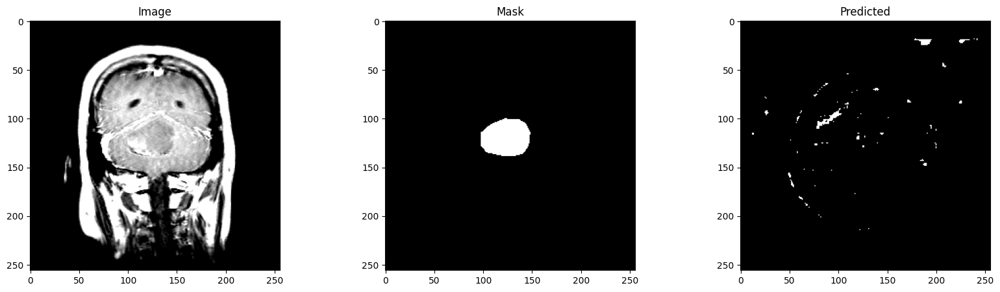

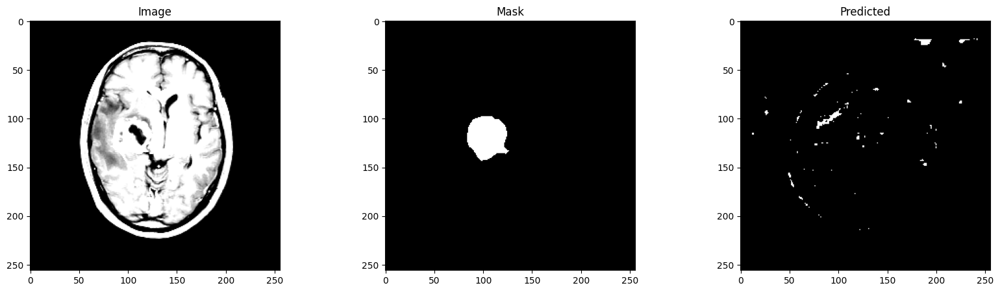

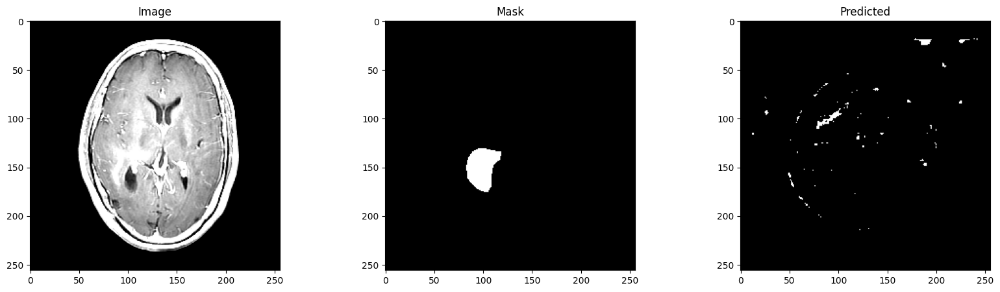

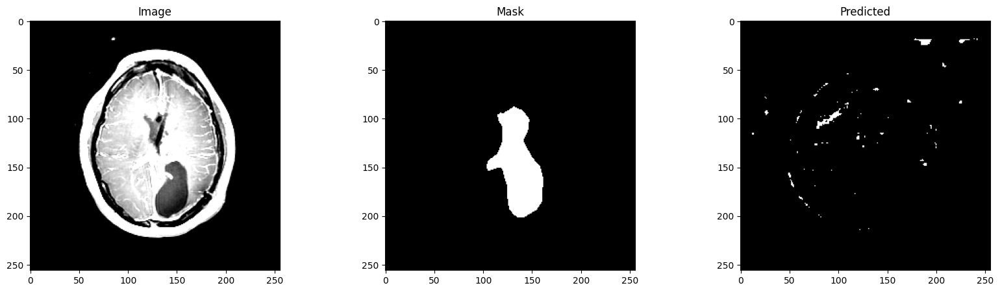

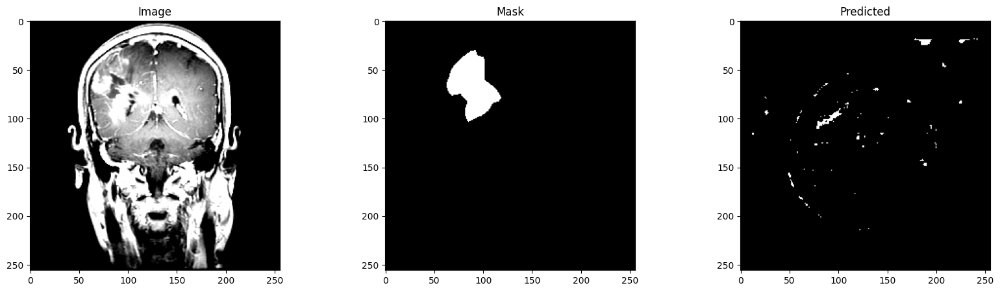

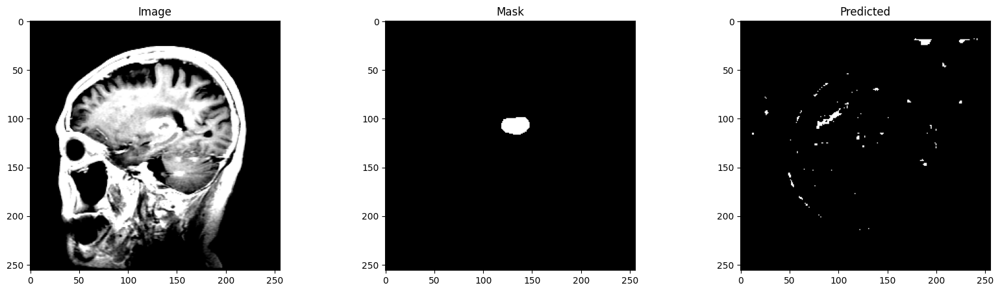

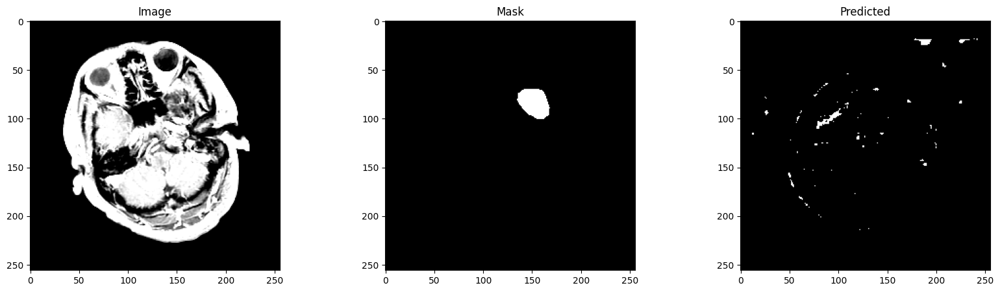

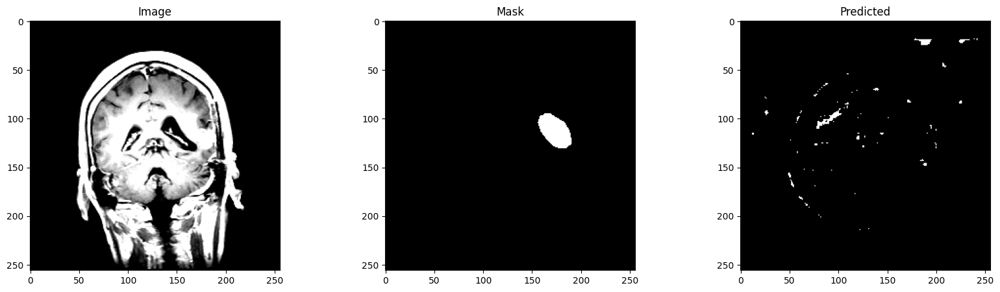

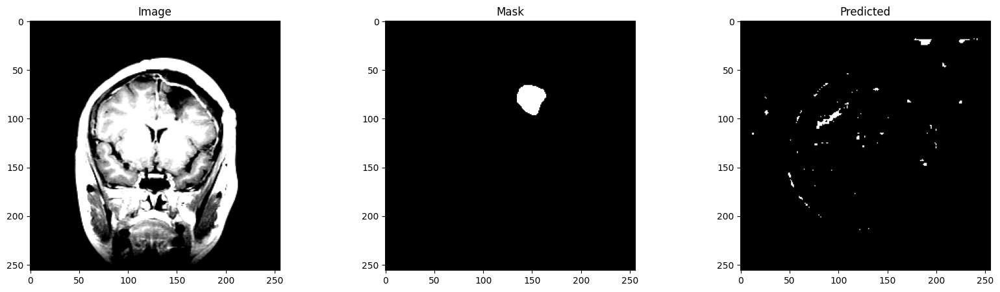

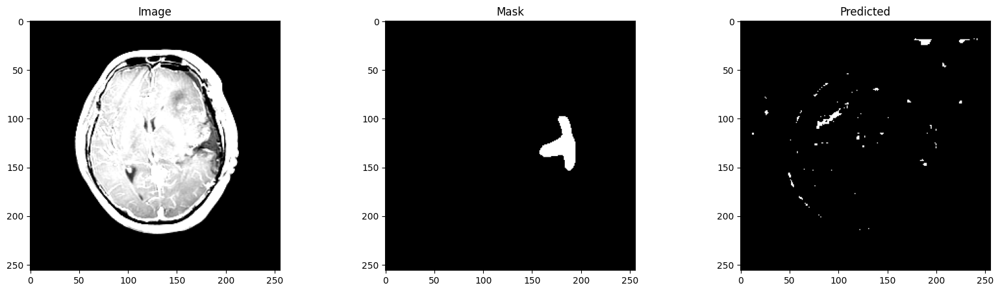

In [ ]:
for i in range(10):
  fig, arr = plt.subplots(1,3,figsize=(20,5))

  tensor = torch.from_numpy(preprocessed_masks[i])
  image_tensor = preprocessed_images[i].squeeze(0)  # Now the shape is (3, 256, 256)
  image_np = image_tensor.permute(1, 2, 0).numpy()
  arr[0].imshow(np.array(image_np))
  arr[0].set_title('Image')
  arr[1].imshow(preprocessed_masks[i],cmap='gray')
  arr[1].set_title('Mask')
  arr[2].imshow(pred_masks_array[i],cmap='gray')
  arr[2].set_title('Predicted')

In [ ]:
ground_truth_masks = []
for i in range(len(preprocessed_images)):
  ground_truth_tensor = torch.from_numpy(preprocessed_masks[i])
  ground_truth_tensor = ground_truth_tensor.to(pred_masks_tensors[0])
  ground_truth_masks.append(ground_truth_tensor)

In [ ]:
DSC_ = DSC_avg()
dsc_value = DSC_(pred_masks_tensors,ground_truth_masks)
print("result: ")
print(dsc_value)

result: 
0.028845371788519147


In [ ]:
target_masks_array = np.array(preprocessed_masks)
target_masks = target_masks_array.astype(bool)
pred_mask_array = np.array(pred_masks_tensors)
pred_masks = pred_mask_array.astype(bool)

Streaming output truncated to the last 5000 lines.
0.006697225138327322
0.0021675169156976024
0.01704410545115434
0.012511386663196445
0.014208206711110404
0.0025933737370901575
0.0029284021183705795
0.00904070256217908
0.01903825874466388
0.005492599727405516
0.018043285744634634
0.01683846285059824
0.010241098771331631
0.01133118034684239
0.01669217230285149
0.0029838542539086786
0.013136249850995351
0.009443596497251986
0.004225608620650846
0.01256141956500563
0.00885870588200144
0.005181759316268688
0.004060570396977338
0.02052392688578386
0.0046201522789245
0.00713461838208552
0.011996022638331272
0.010466783182451938
0.003220919637639617
0.011904578090017756
0.005473190277198588
0.012738732940886979
0.00716442478841396
0.004822428124682667
0.004548334964434495
0.010350076758942471
0.0035924892142547324
0.0035541875748810675
0.01484243620677049
0.0010825851969852266
0.0031765307786154823
0.0172537559258544
0.018871238593026876
0.01937658652209751
0.004957721817389575
0.00221205590

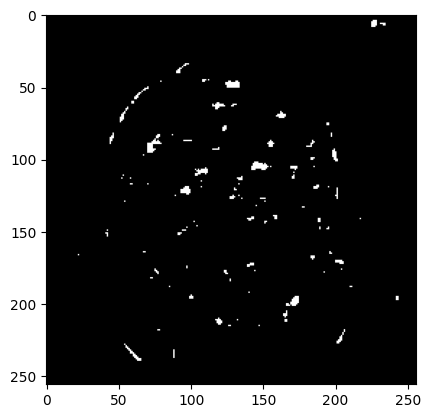

In [ ]:
# Calculate mAP
mAP = compute_mean_average_precision(pred_masks, target_masks)
print(f'mAP: {mAP:.4f}')

# **Creating smaller training and test sets**

In [ ]:
train100_images = []
train100_masks = []
test100_images = []
test100_masks = []

train300_images = []
train300_masks = []
test300_images = []
test300_masks = []

train500_images = []
train500_masks = []
test500_images = []
test500_masks = []

train700_images = []
train700_masks = []
test700_images = []
test700_masks = []

train900_images = []
train900_masks = []
test900_images = []
test900_masks = []

train1100_images = []
train1100_masks = []
test1100_images = []
test1100_masks = []

train1300_images = []
train1300_masks = []
test1300_images = []
test1300_masks = []

for i in range(len(preprocessed_images)):
  if(i < 100):
    train100_images.append(preprocessed_images[i])
    train100_masks.append((masks[i]))
  else:
    test100_images.append(preprocessed_images[i])
    test100_masks.append((masks[i]))

for i in range(len(preprocessed_images)):
  if( i < 300):
    train300_images.append(preprocessed_images[i])
    train300_masks.append((masks[i]))
  else:
    test300_images.append(preprocessed_images[i])
    test300_masks.append((masks[i]))

for i in range(len(preprocessed_images)):
  if(i < 500):
    train500_images.append(preprocessed_images[i])
    train500_masks.append((masks[i]))
  else:
    test500_images.append(preprocessed_images[i])
    test500_masks.append((masks[i]))

for i in range(len(preprocessed_images)):
  if(i < 700):
    train700_images.append(preprocessed_images[i])
    train700_masks.append((masks[i]))
  else:
    test700_images.append(preprocessed_images[i])
    test700_masks.append((masks[i]))

for i in range(len(preprocessed_images)):
  if(i < 900):
    train900_images.append(preprocessed_images[i])
    train900_masks.append((masks[i]))
  else:
    test900_images.append(preprocessed_images[i])
    test900_masks.append((masks[i]))

for i in range(len(preprocessed_images)):
  if(i < 1100):
    train1100_images.append(preprocessed_images[i])
    train1100_masks.append((masks[i]))
  else:
    test1100_images.append(preprocessed_images[i])
    test1100_masks.append((masks[i]))

for i in range(len(preprocessed_images)):
  if(i < 1300):
    train1300_images.append(preprocessed_images[i])
    train1300_masks.append((masks[i]))
  else:
    test1300_images.append(preprocessed_images[i])
    test1300_masks.append((masks[i]))

#print(len(preprocessed_images))
#print(train1300_images[0].shape)
#print(train1300_masks[0].shape)
#print(len(train1300_masks))
#print(len(test1300_images))
#print(len(test1300_masks))



#**Train 100**

In [ ]:
model = torch.hub.load('mateuszbuda/brain-segmentation-pytorch', 'unet',
    in_channels=3, out_channels=1, init_features=32, pretrained=True)

/usr/local/lib/python3.10/dist-packages/torch/hub.py:293: UserWarning: You are about to download and run code from an untrusted repository. In a future release, this won't be allowed. To add the repository to your trusted list, change the command to {calling_fn}(..., trust_repo=False) and a command prompt will appear asking for an explicit confirmation of trust, or load(..., trust_repo=True), which will assume that the prompt is to be answered with 'yes'. You can also use load(..., trust_repo='check') which will only prompt for confirmation if the repo is not already trusted. This will eventually be the default behaviour
  warnings.warn(
Downloading: "https://github.com/mateuszbuda/brain-segmentation-pytorch/zipball/master" to /root/.cache/torch/hub/master.zip
Downloading: "https://github.com/mateuszbuda/brain-segmentation-pytorch/releases/download/v1.0/unet-e012d006.pt" to /root/.cache/torch/hub/checkpoints/unet-e012d006.pt


In [ ]:
model100 = model

#for param in model100.encoder1.parameters():
#    param.requires_grad = False
#for param in model100.encoder2.parameters():
#    param.requires_grad = False
#for param in model100.encoder3.parameters():
#    param.requires_grad = False
#for param in model100.encoder4.parameters():
 #   param.requires_grad = False

#criterion = nn.BCEWithLogitsLoss()
criterion = DiceLoss()
optimizer = optim.Adam(model100.parameters(), lr=0.001)

In [ ]:
for img in train100_images:
  print(img.shape)
  break
for m in train100_masks:
  print(m.shape)
  break

torch.Size([1, 3, 256, 256])
(256, 256, 1)


In [ ]:
# Create an instance of CustomDataset
dataset = CustomDataset(train100_images, train100_masks)

# Create DataLoader for the dataset
batch_size = 64
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)
for batch_idx, (inputs, targets) in enumerate(dataloader):
    print(f"Batch {batch_idx}:")
    print("Inputs shape:", inputs.shape)
    print("Targets shape:", targets.shape)

Batch 0:
Inputs shape: torch.Size([64, 1, 3, 256, 256])
Targets shape: torch.Size([64, 256, 256, 1])
Batch 1:
Inputs shape: torch.Size([36, 1, 3, 256, 256])
Targets shape: torch.Size([36, 256, 256, 1])


<ipython-input-12-d7a005a2073e>:13: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  image_tensor = torch.tensor(image, dtype=torch.float32)


In [ ]:
# For checking
for images, masks in dataloader:
    print(images.shape)
    print(masks.shape)
    break

torch.Size([64, 1, 3, 256, 256])
torch.Size([64, 256, 256, 1])


<ipython-input-12-d7a005a2073e>:13: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  image_tensor = torch.tensor(image, dtype=torch.float32)


In [ ]:
# Training loop
num_epochs = 30  # Define number of epochs
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Ensure the model is on GPU if available
model100.to(device)  # Move the model to the GPU
model100.train()  # Set model to training mode
for epoch in range(num_epochs):
    running_loss = 0.0
    for images, masks in dataloader:
        images, masks = images.to(device), masks.to(device)
        optimizer.zero_grad()  # Zero the gradients
        if images.shape[1] == 1:
           images = images.squeeze(1)

        masks = masks.permute(0, 3, 1, 2)
        outputs = model100(images)

        # Compute the loss
        loss = criterion(outputs, masks)

        # Backward pass and optimize
        loss.backward()
        optimizer.step()

        running_loss += loss.item() * images.size(0)

    epoch_loss = running_loss / len(dataloader.dataset)
    print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {epoch_loss:.4f}")

print("Training finished!")

<ipython-input-12-d7a005a2073e>:13: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  image_tensor = torch.tensor(image, dtype=torch.float32)


Epoch [1/30], Loss: 0.0404
Epoch [2/30], Loss: 0.0432
Epoch [3/30], Loss: 0.0425
Epoch [4/30], Loss: 0.0379
Epoch [5/30], Loss: 0.0343
Epoch [6/30], Loss: 0.0324
Epoch [7/30], Loss: 0.0307
Epoch [8/30], Loss: 0.0285
Epoch [9/30], Loss: 0.0271
Epoch [10/30], Loss: 0.0264
Epoch [11/30], Loss: 0.0249
Epoch [12/30], Loss: 0.0245
Epoch [13/30], Loss: 0.0236
Epoch [14/30], Loss: 0.0233
Epoch [15/30], Loss: 0.0227
Epoch [16/30], Loss: 0.0221
Epoch [17/30], Loss: 0.0216
Epoch [18/30], Loss: 0.0215
Epoch [19/30], Loss: 0.0210
Epoch [20/30], Loss: 0.0203
Epoch [21/30], Loss: 0.0203
Epoch [22/30], Loss: 0.0199
Epoch [23/30], Loss: 0.0191
Epoch [24/30], Loss: 0.0191
Epoch [25/30], Loss: 0.0194
Epoch [26/30], Loss: 0.0193
Epoch [27/30], Loss: 0.0195
Epoch [28/30], Loss: 0.0190
Epoch [29/30], Loss: 0.0203
Epoch [30/30], Loss: 0.0203
Training finished!


In [ ]:
pred_masks_array100 = []
pred_mask_tensor100 = []
model100.eval()

for input_image in test100_images:
  if torch.cuda.is_available():
      input_image = input_image.to('cuda')
      model = model100.to('cuda')

  with torch.no_grad():
      output = model100(input_image)


  pred_mask_tensor100.append(torch.round(output[0]).permute(1,2,0))

  numpy_array = torch.round(output[0]).cpu().numpy()
  array = numpy_array.copy()

    # Reshape the tensor if it has a single channel
  if array.ndim == 3 and array.shape[0] == 1:
      array = np.squeeze(array, axis=0)
  pred_masks_array100.append(array)



(256, 256, 1)
before: 
<class 'numpy.ndarray'>
<class 'torch.Tensor'>
before: 
<class 'numpy.ndarray'>
<class 'torch.Tensor'>
before: 
<class 'numpy.ndarray'>
<class 'torch.Tensor'>
before: 
<class 'numpy.ndarray'>
<class 'torch.Tensor'>


before: 
<class 'numpy.ndarray'>
<class 'torch.Tensor'>
before: 
<class 'numpy.ndarray'>
<class 'torch.Tensor'>
before: 
<class 'numpy.ndarray'>
<class 'torch.Tensor'>
before: 
<class 'numpy.ndarray'>
<class 'torch.Tensor'>


before: 
<class 'numpy.ndarray'>
<class 'torch.Tensor'>
before: 
<class 'numpy.ndarray'>
<class 'torch.Tensor'>


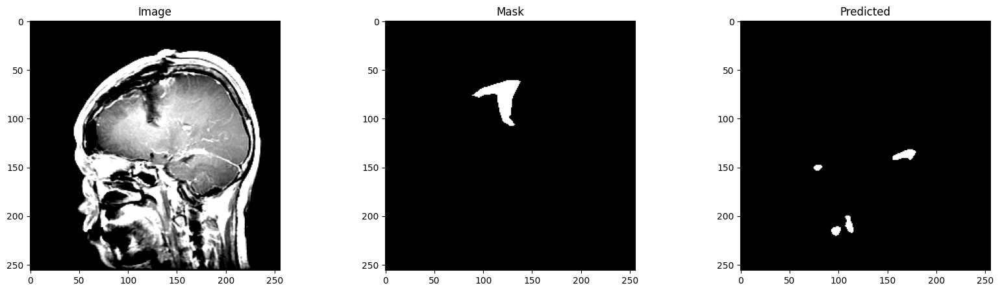

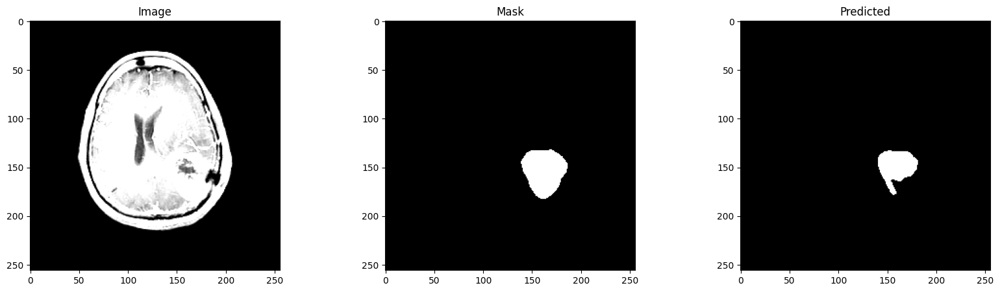

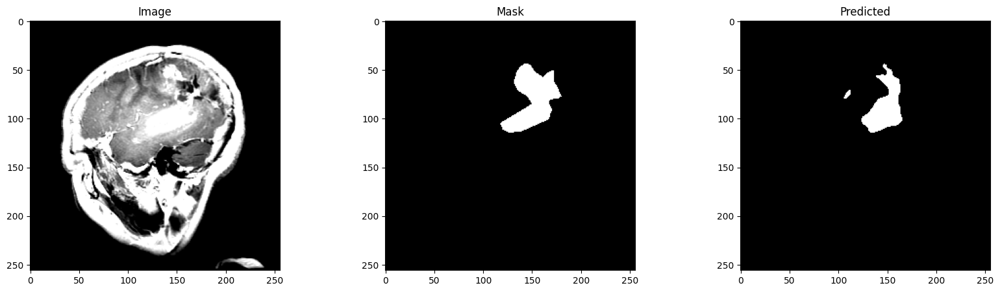

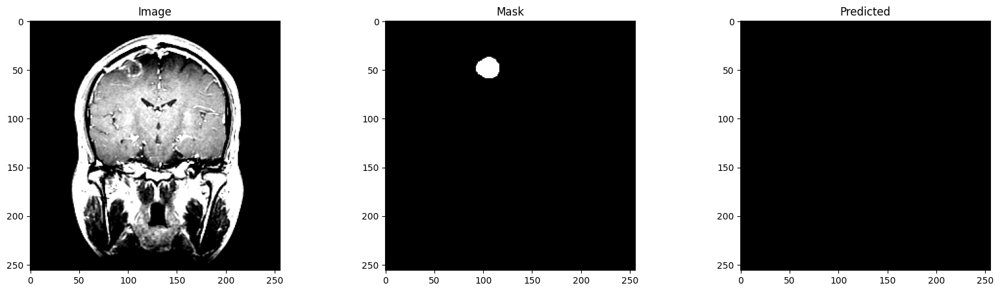

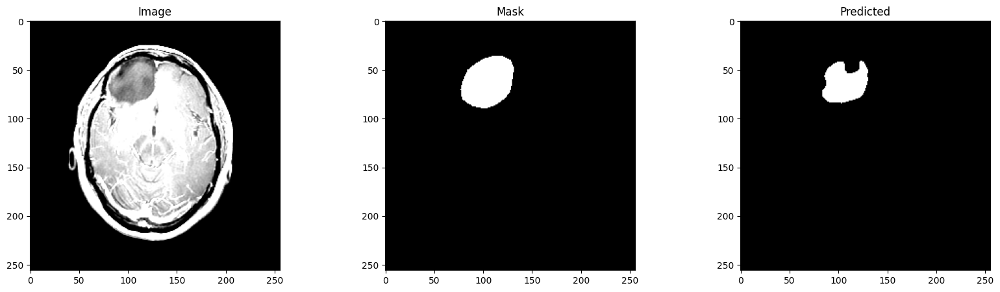

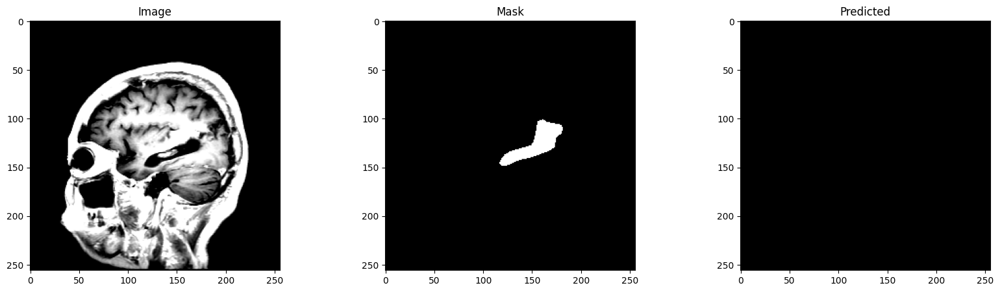

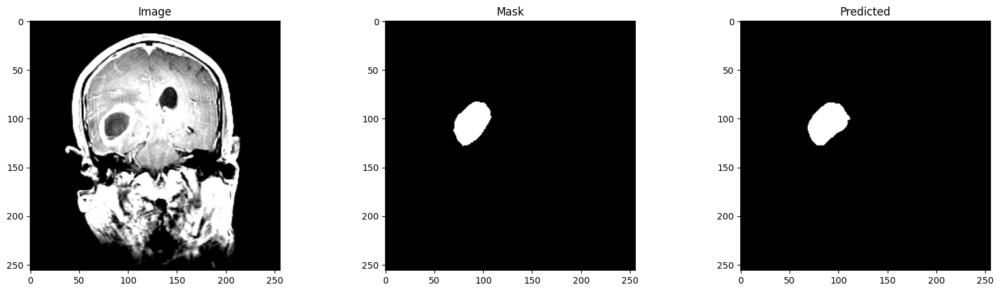

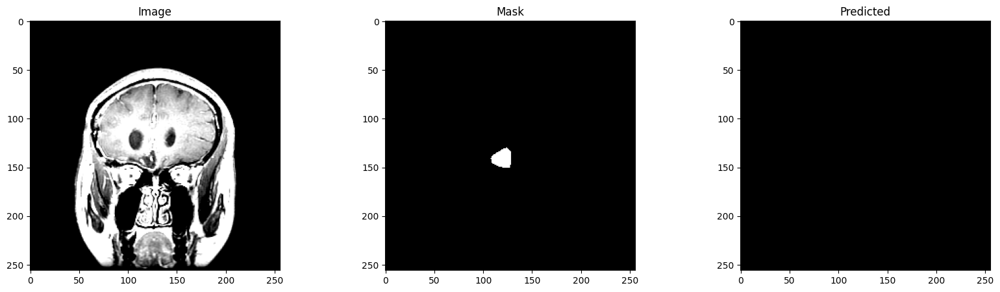

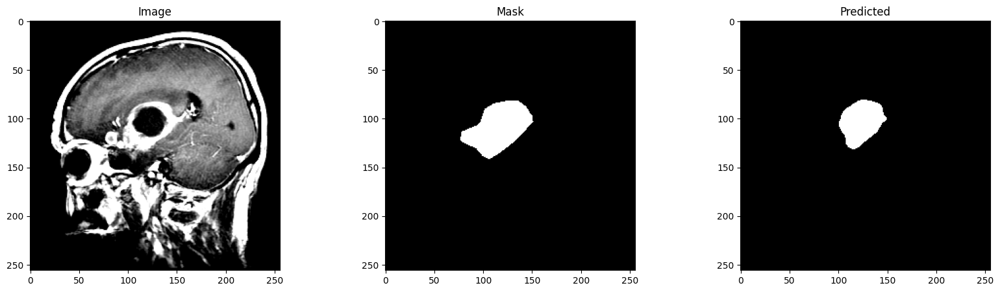

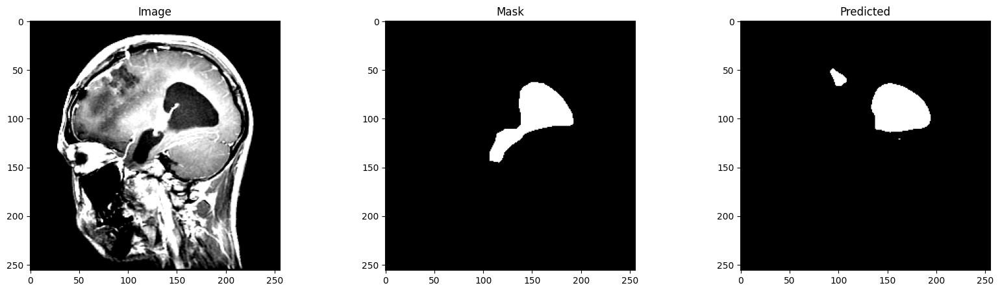

In [ ]:
print(raw_images[0].shape)

for i in range(10):
  fig, arr = plt.subplots(1,3,figsize=(20,5))
  print("before: ")
  print(type(test100_masks[i]))
  print(type(pred_mask_tensor100[i]))

  tensor = torch.from_numpy(test100_masks[i])
  image_tensor = test100_images[i].squeeze(0)  # Now the shape is (3, 256, 256)
  image_np = image_tensor.permute(1, 2, 0).numpy()
  arr[0].imshow(np.array(image_np))
  #arr[0].imshow(raw_images[i])
  arr[0].set_title('Image')
  arr[1].imshow(test100_masks[i],cmap='gray')
  arr[1].set_title('Mask')
  arr[2].imshow(pred_masks_array100[i],cmap='gray')
  arr[2].set_title('Predicted')


In [ ]:
ground_truth_masks = []
for i in range(len(test100_images)):
  ground_truth_tensor = torch.from_numpy(test100_masks[i])
  ground_truth_tensor = ground_truth_tensor.to(pred_mask_tensor100[0])
  ground_truth_masks.append(ground_truth_tensor)

In [ ]:
DSC_ = DSC_avg()
dsc_value = DSC_(pred_mask_tensor100,ground_truth_masks)
print("result: ")
print(dsc_value)

result: 
0.3725301300507548


In [ ]:
target_masks_array = np.array(test100_masks)
target_masks = target_masks_array.astype(bool)
pred_mask_array = np.array(pred_masks_tensors100)
pred_masks = pred_mask_array.astype(bool)

mAP = compute_mean_average_precision(pred_masks, target_masks)
print(f'mAP: {mAP:.4f}')

#map value  = 0 --> to 2 unique recall values

Streaming output truncated to the last 5000 lines.
0.011480575016007665
0.01888884425340457
0.008587104931702921
0.00016638989393459897
0.02672484818174902
0.017462493925413776
0.035580754770951184
0.029668132583879125
0.017173754968939425
0.026061566451801594
0.0644435619382512
0.04206281236672067
0.012652245858285914
0.025401150104280942
0.04415261837396027
0.022151725646775693
0.01778196599735696
0.07770314930127285
0.043965066806001346
0.025346174367521162
0.008288547249000435
0.038448129414986126
0.008269317297346111
0.05479834817601462
0.011980624490684268
0.028893906226719997
0.01533864714804813
0.07407851502072538
0.015811125055885847
0.02272547204500807
0.0011288825316554082
0.0
0.004260149137782657
0.04702180965484761
0.017151033131856924
0.011031545550233736
0.00030057108506161706
0.00617206724847269
0.003749646033725311
0.019636136437782867
0.02486988687685492
0.048447559092528805
0.015255182200598044
0.010362658337671351
0.017026466884166477
0.019459975423979543
0.03216163

# **Train 300**

In [ ]:
model = torch.hub.load('mateuszbuda/brain-segmentation-pytorch', 'unet',
    in_channels=3, out_channels=1, init_features=32, pretrained=True)

Using cache found in /root/.cache/torch/hub/mateuszbuda_brain-segmentation-pytorch_master


In [ ]:
model300 = model

#for param in model300.encoder1.parameters():
#    param.requires_grad = False
#for param in model300.encoder2.parameters():
#    param.requires_grad = False
#for param in model300.encoder3.parameters():
#    param.requires_grad = False
#for param in model300.encoder4.parameters():
#    param.requires_grad = False

#criterion = nn.BCEWithLogitsLoss()
criterion = DiceLoss()
optimizer = optim.Adam(model300.parameters(), lr=0.001)

In [ ]:
dataset = CustomDataset(train300_images, train300_masks)
batch_size = 64
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

In [ ]:
# Training loop
num_epochs = 30  # Define number of epochs
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Ensure the model is on GPU if available
model300.to(device)  # Move the model to the GPU
model300.train()  # Set model to training mode
for epoch in range(num_epochs):
    running_loss = 0.0
    for images, masks in dataloader:
        images, masks = images.to(device), masks.to(device)
        optimizer.zero_grad()  # Zero the gradients

        if images.shape[1] == 1:
           images = images.squeeze(1)
        masks = masks.permute(0, 3, 1, 2)

        outputs = model300(images)
        # Compute the loss
        loss = criterion(outputs, masks)
        # Backward pass and optimize
        loss.backward()
        optimizer.step()
        running_loss += loss.item() * images.size(0)

    epoch_loss = running_loss / len(dataloader.dataset)
    print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {epoch_loss:.4f}")

print("Training finished!")

<ipython-input-12-d7a005a2073e>:13: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  image_tensor = torch.tensor(image, dtype=torch.float32)


Epoch [1/30], Loss: 0.0716
Epoch [2/30], Loss: 0.0629
Epoch [3/30], Loss: 0.0580
Epoch [4/30], Loss: 0.0514
Epoch [5/30], Loss: 0.0451
Epoch [6/30], Loss: 0.0400
Epoch [7/30], Loss: 0.0366
Epoch [8/30], Loss: 0.0344
Epoch [9/30], Loss: 0.0344
Epoch [10/30], Loss: 0.0334
Epoch [11/30], Loss: 0.0332
Epoch [12/30], Loss: 0.0310
Epoch [13/30], Loss: 0.0291
Epoch [14/30], Loss: 0.0280
Epoch [15/30], Loss: 0.0278
Epoch [16/30], Loss: 0.0278
Epoch [17/30], Loss: 0.0258
Epoch [18/30], Loss: 0.0264
Epoch [19/30], Loss: 0.0252
Epoch [20/30], Loss: 0.0242
Epoch [21/30], Loss: 0.0241
Epoch [22/30], Loss: 0.0240
Epoch [23/30], Loss: 0.0247
Epoch [24/30], Loss: 0.0231
Epoch [25/30], Loss: 0.0238
Epoch [26/30], Loss: 0.0249
Epoch [27/30], Loss: 0.0247
Epoch [28/30], Loss: 0.0248
Epoch [29/30], Loss: 0.0240
Epoch [30/30], Loss: 0.0248
Training finished!


In [ ]:
pred_masks_array300 = []
pred_masks_tensors300 = []
model300.eval()

for input_image in test300_images:

  if torch.cuda.is_available():
      input_image = input_image.to('cuda')
      model = model300.to('cuda')

  with torch.no_grad():
      output = model300(input_image)

  pred_masks_tensors300.append(torch.round(output[0]).permute(1,2,0))

  numpy_array = torch.round(output[0]).cpu().numpy()
  array = numpy_array.copy()

    # Reshape the tensor if it has a single channel
  if array.ndim == 3 and array.shape[0] == 1:
      array = np.squeeze(array, axis=0)
  pred_masks_array300.append(array)

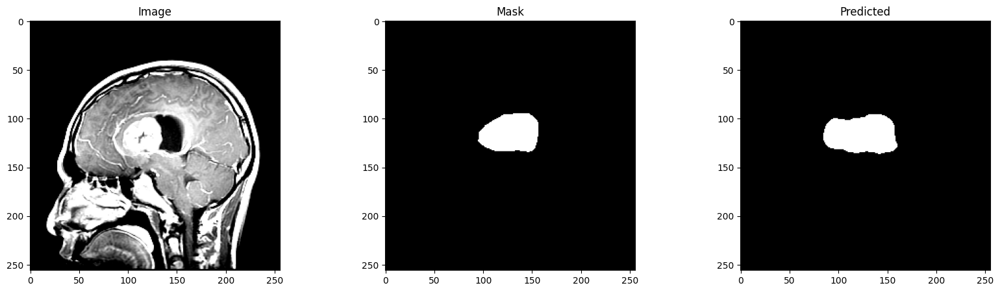

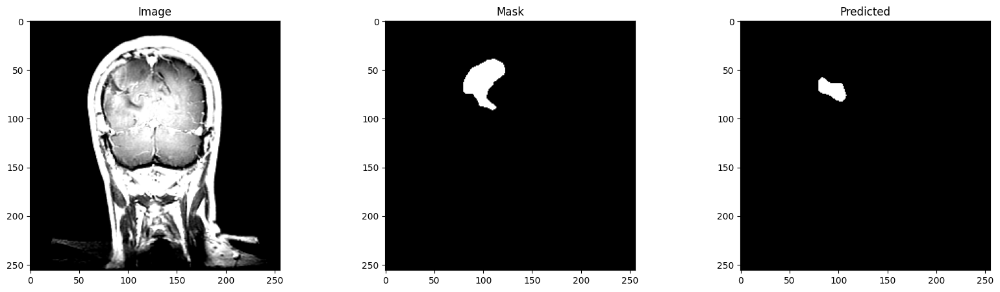

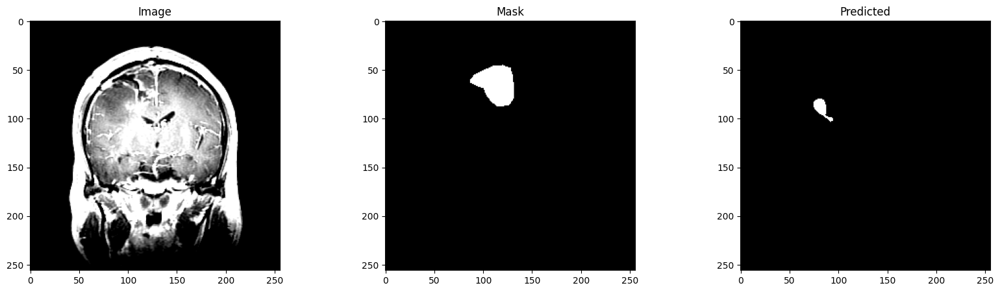

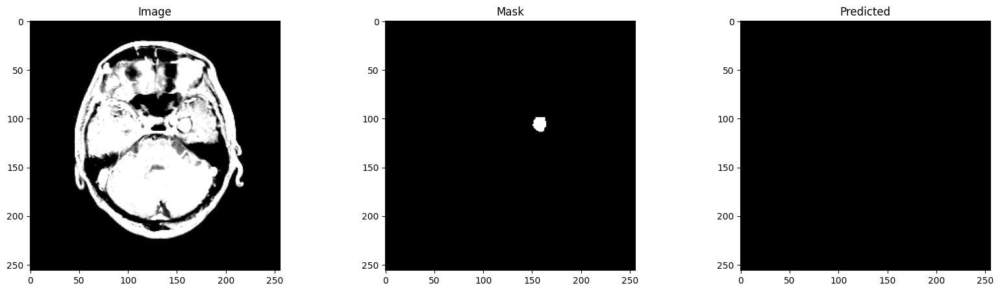

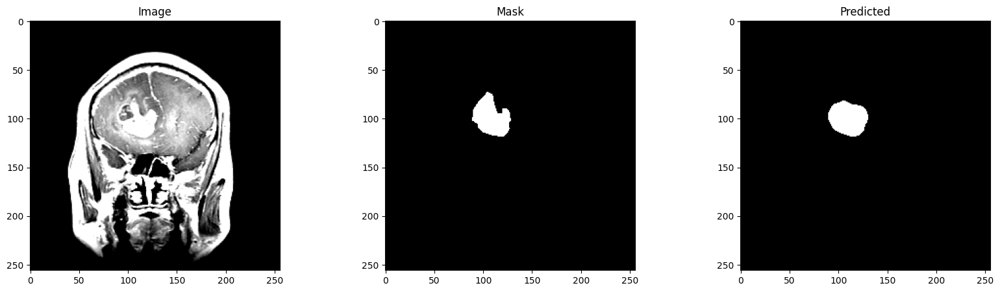

...

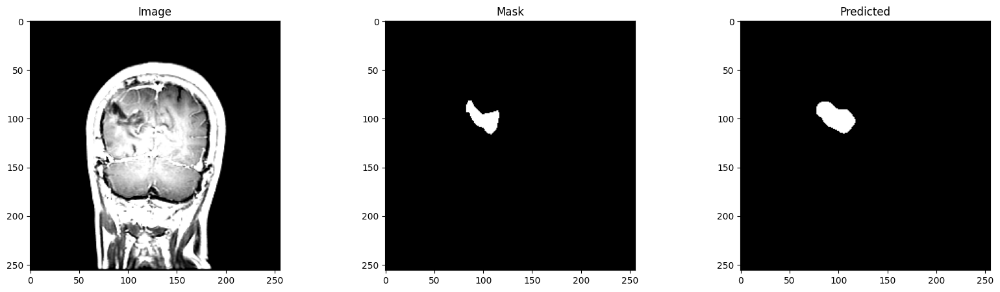

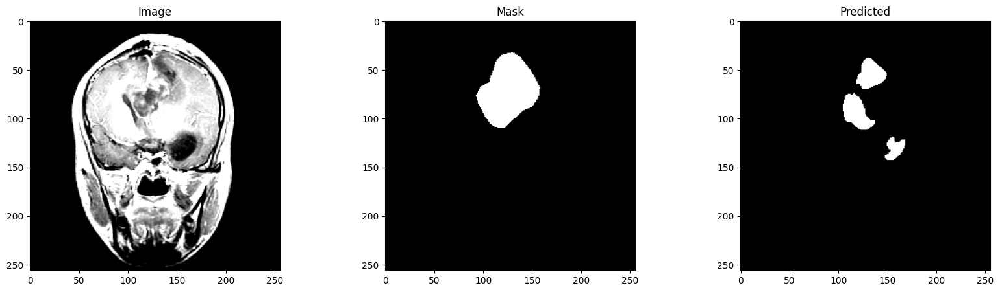

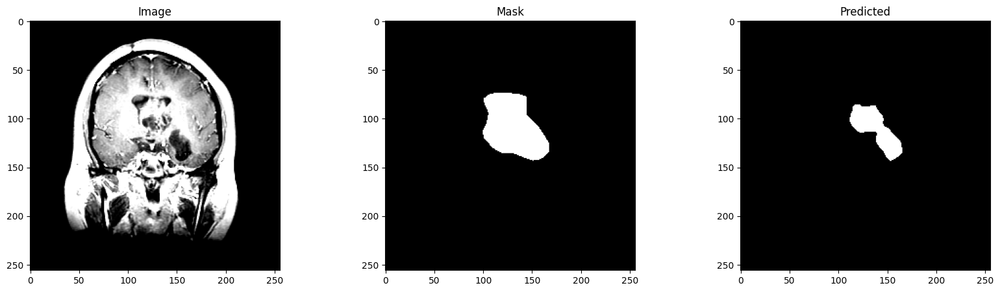

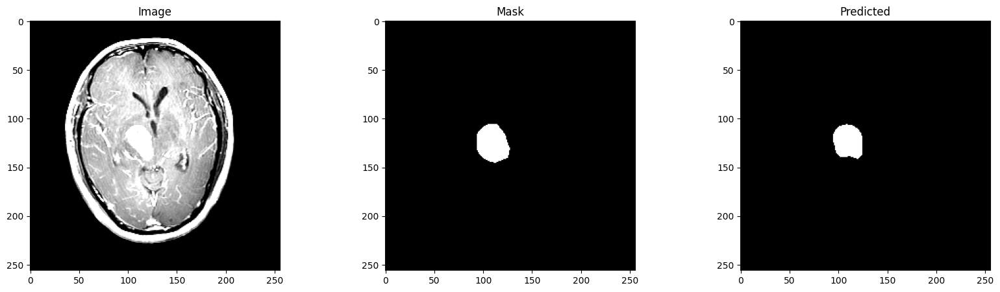

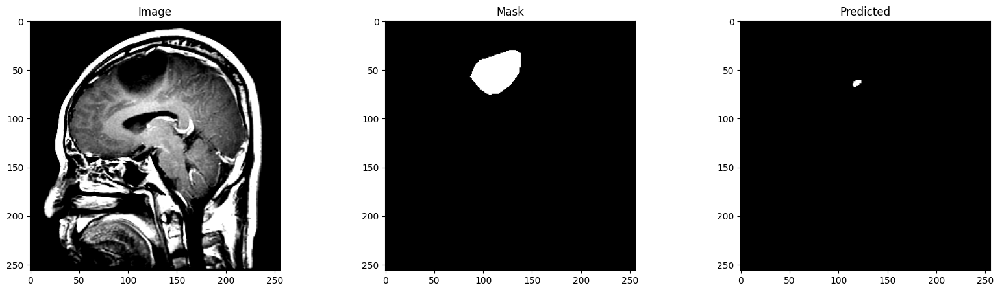

In [ ]:
for i in range(20):
  fig, arr = plt.subplots(1,3,figsize=(20,5))
  image_tensor = test300_images[i].squeeze(0)  # Now the shape is (3, 256, 256)
  image_np = image_tensor.permute(1, 2, 0).numpy()
  arr[0].imshow(image_np)
  arr[0].set_title('Image')
  arr[1].imshow(test300_masks[i],cmap='gray')
  arr[1].set_title('Mask')
  arr[2].imshow(pred_masks_tensors300[i].cpu(),cmap='gray')
  arr[2].set_title('Predicted')

In [ ]:
ground_truth_masks = []
for i in range(len(test300_images)):
  ground_truth_tensor = torch.from_numpy(test300_masks[i])
  ground_truth_tensor = ground_truth_tensor.to(pred_masks_tensors300[0])
  ground_truth_masks.append(ground_truth_tensor)

In [ ]:
DSC_ = DSC_avg()
dsc_value = DSC_(pred_masks_tensors300,ground_truth_masks)
print("result: ")
print(dsc_value)

result: 
0.5351983664306259


In [ ]:
target_masks_array = np.array(test300_masks)
target_masks = target_masks_array.astype(bool)
pred_mask_array = np.array(pred_masks_tensors300)
pred_masks = pred_mask_array.astype(bool)

mAP = compute_mean_average_precision(pred_masks, target_masks)
print(f'mAP: {mAP:.4f}')  #map is 0 here, still no 2 unique recall value

Streaming output truncated to the last 5000 lines.
0.0
0.003840841579475148
0.00028130661295585734
0.012927084528778906
0.006903369867216663
0.0
0.0005717313545626696
0.030147358646121978
0.0
0.0
3.057363188876842e-05
0.0
0.00015481303282210244
0.0
0.011500875849519676
0.0
0.01350721937587331
0.0
0.0
0.0
0.0
0.05372411329938698
0.02869335729125723
0.05239876344574149
0.00010365098246324091
0.0003516062010548186
0.0069314164532454665
0.0
0.000207158783866563
0.0
0.0
0.0003776003934069215
0.0
0.03256427383952828
0.0008435228447991316
0.03342587371649601
0.000586022712897921
0.0010427528675703858
0.0
0.0
0.0
2.618333571668825e-05
0.0006270205125281956
0.0
0.012449711939766513
4.583441553481124e-05
0.052613839013174526
0.03902303521641169
0.0
0.0
0.0
0.0001473204673458518
0.0
0.00017699231066739212
0.0
0.0
0.0011938204734897463
4.332442775651672e-05
0.005834416139822165
0.03884301131646786
6.173746250513592e-05
0.03879931022027882
0.00012663241304798829
0.003917389295244597
0.0671520006893

# **Train 500**

In [ ]:
model = torch.hub.load('mateuszbuda/brain-segmentation-pytorch', 'unet',
    in_channels=3, out_channels=1, init_features=32, pretrained=True)

Using cache found in /root/.cache/torch/hub/mateuszbuda_brain-segmentation-pytorch_master


In [ ]:
model500 = model

#for param in model500.encoder1.parameters():
#    param.requires_grad = False
#for param in model500.encoder2.parameters():
#    param.requires_grad = False
#for param in model500.encoder3.parameters():
#    param.requires_grad = False
#for param in model500.encoder4.parameters():
#    param.requires_grad = False

#criterion = nn.BCEWithLogitsLoss()
criterion = DiceLoss()
optimizer = optim.Adam(model500.parameters(), lr=0.001)

In [ ]:
dataset = CustomDataset(train500_images, train500_masks)
batch_size = 64
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

In [ ]:
# Training loop
num_epochs = 30  # Define number of epochs

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Ensure the model is on GPU if available
model500.to(device)  # Move the model to the GPU
model500.train()  # Set model to training mode
for epoch in range(num_epochs):
    running_loss = 0.0
    for images, masks in dataloader:
        images, masks = images.to(device), masks.to(device)
        optimizer.zero_grad()  # Zero the gradients

        if images.shape[1] == 1:
           images = images.squeeze(1)
        masks = masks.permute(0, 3, 1, 2)

        outputs = model500(images)
        # Compute the loss
        loss = criterion(outputs, masks)
        # Backward pass and optimize
        loss.backward()
        optimizer.step()
        running_loss += loss.item() * images.size(0)

    epoch_loss = running_loss / len(dataloader.dataset)
    print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {epoch_loss:.4f}")

print("Training finished!")

<ipython-input-11-d7a005a2073e>:13: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  image_tensor = torch.tensor(image, dtype=torch.float32)
/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:744: UserWarning: Plan failed with an OutOfMemoryError: CUDA out of memory. Tried to allocate 2.25 GiB. GPU  (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:924.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass
/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:744: UserWarning: Plan failed with an OutOfMemoryError: CUDA out of memory. Tried to allocate 3.38 GiB. GPU  (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:924.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass


Epoch [1/30], Loss: 0.6749
Epoch [2/30], Loss: 0.4762
Epoch [3/30], Loss: 0.4167
Epoch [4/30], Loss: 0.3775
Epoch [5/30], Loss: 0.3493
Epoch [6/30], Loss: 0.3171
Epoch [7/30], Loss: 0.3150
Epoch [8/30], Loss: 0.2729
Epoch [9/30], Loss: 0.2435
Epoch [10/30], Loss: 0.2308
Epoch [11/30], Loss: 0.2318
Epoch [12/30], Loss: 0.2215
Epoch [13/30], Loss: 0.2048
Epoch [14/30], Loss: 0.1903
Epoch [15/30], Loss: 0.1872
Epoch [16/30], Loss: 0.1715
Epoch [17/30], Loss: 0.1663
Epoch [18/30], Loss: 0.1594
Epoch [19/30], Loss: 0.1464
Epoch [20/30], Loss: 0.1443
Epoch [21/30], Loss: 0.1321
Epoch [22/30], Loss: 0.1246
Epoch [23/30], Loss: 0.1182
Epoch [24/30], Loss: 0.1163
Epoch [25/30], Loss: 0.1199
Epoch [26/30], Loss: 0.1282
Epoch [27/30], Loss: 0.1209
Epoch [28/30], Loss: 0.1180
Epoch [29/30], Loss: 0.1133
Epoch [30/30], Loss: 0.1123
Training finished!


In [ ]:
pred_masks_tensors500 = []
pred_masks_array500 = []
model500.eval()

for input_image in test500_images:

  if torch.cuda.is_available():
      input_image = input_image.to('cuda')
      model = model500.to('cuda')

  with torch.no_grad():
      output = model500(input_image)

  pred_masks_tensors500.append(torch.round(output[0]).permute(1,2,0))

  numpy_array = torch.round(output[0]).cpu().numpy()
  array = numpy_array.copy()
    # Reshape the tensor if it has a single channel
  if array.ndim == 3 and array.shape[0] == 1:
      array = np.squeeze(array, axis=0)
  pred_masks_array500.append(array)


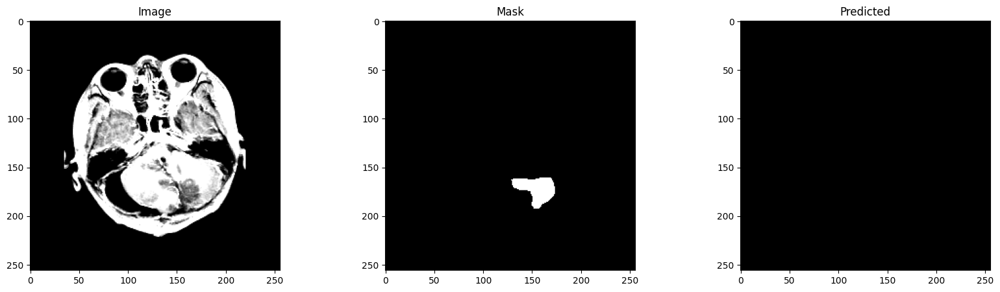

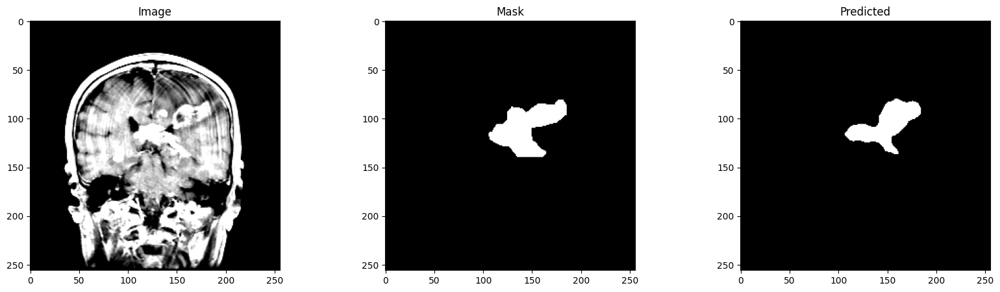

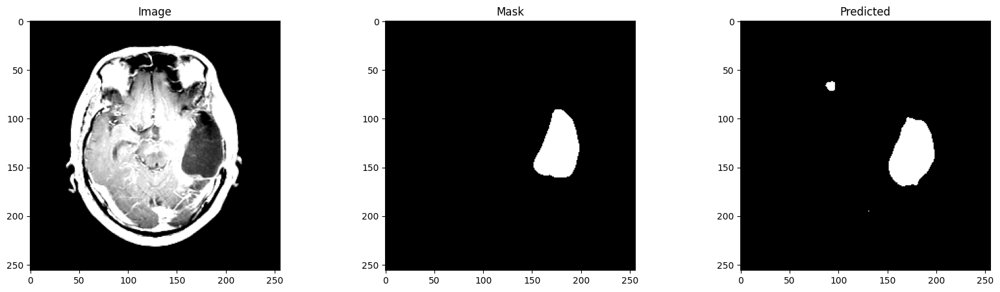

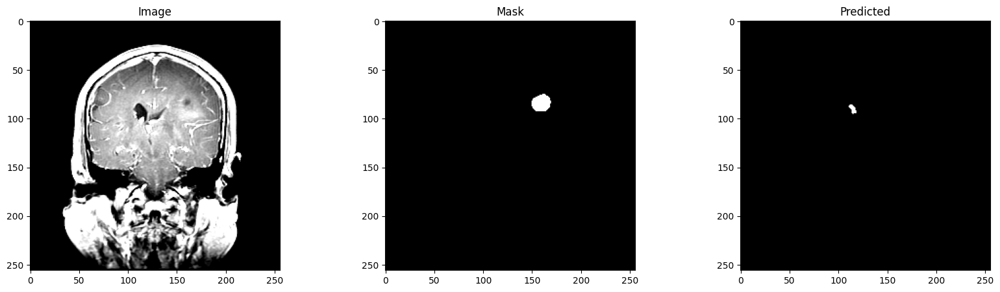

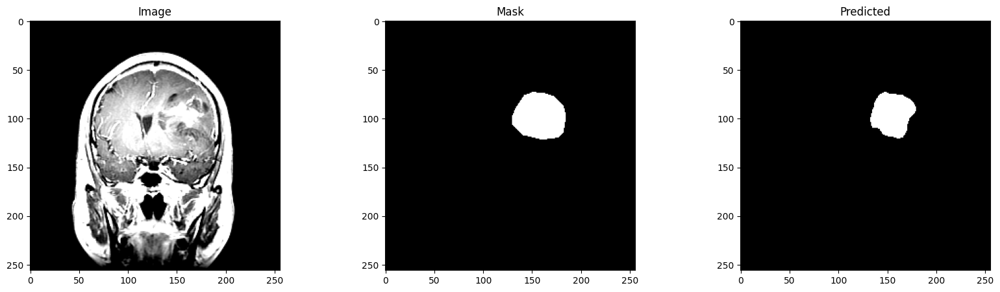

...

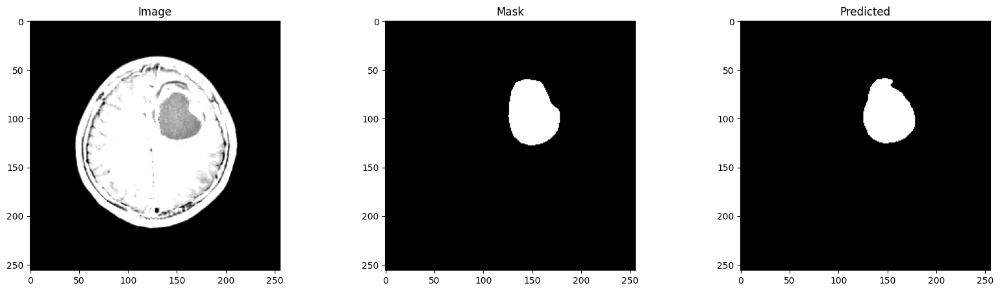

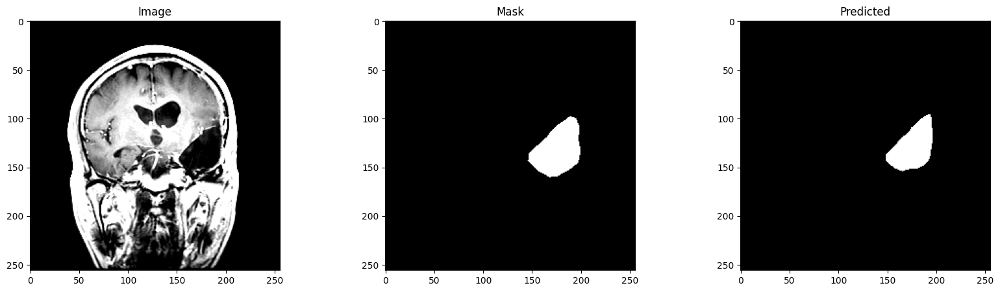

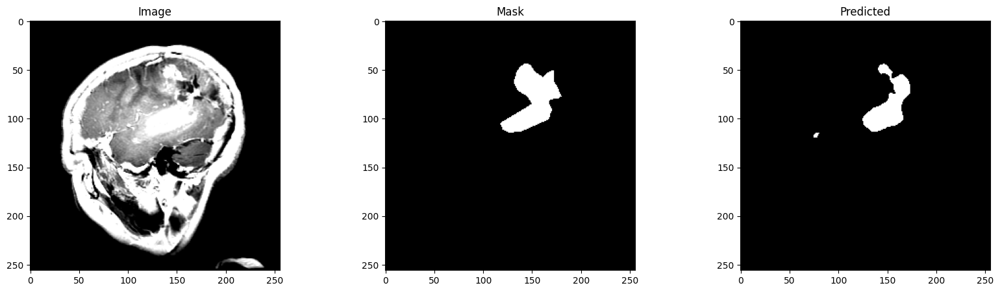

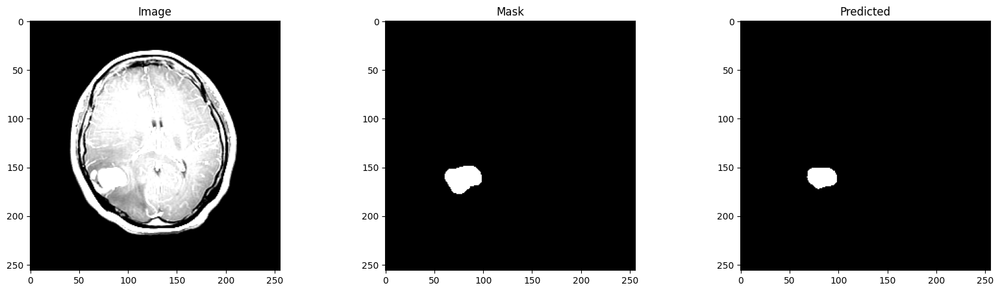

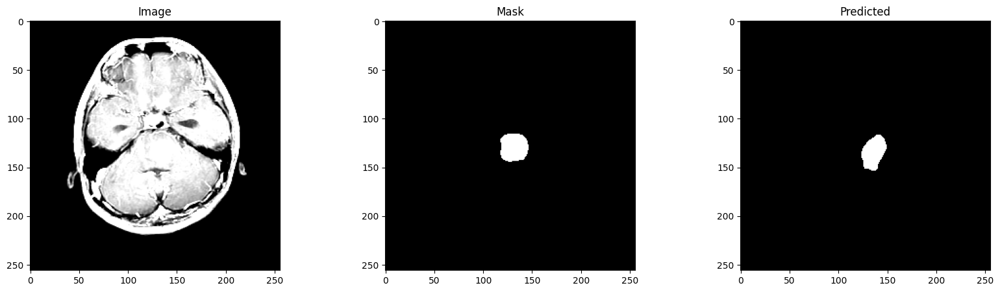

In [ ]:
for i in range(20):
  fig, arr = plt.subplots(1,3,figsize=(20,5))
  image_tensor = test500_images[i].squeeze(0)  # Now the shape is (3, 256, 256)
  image_np = image_tensor.permute(1, 2, 0).numpy()
  arr[0].imshow(image_np)
  arr[0].set_title('Image')
  arr[1].imshow(test500_masks[i],cmap='gray')
  arr[1].set_title('Mask')
  arr[2].imshow(pred_masks_tensors500[i].cpu(),cmap='gray')
  arr[2].set_title('Predicted')

In [ ]:
ground_truth_masks = []
for i in range(len(test500_images)):
  ground_truth_tensor = torch.from_numpy(test500_masks[i])
  ground_truth_tensor = ground_truth_tensor.to(pred_masks_tensors500[0])
  ground_truth_masks.append(ground_truth_tensor)

In [ ]:
DSC_ = DSC_avg()
dsc_value = DSC_(pred_masks_tensors500,ground_truth_masks)
print("result: ")
print(dsc_value)

result: 
0.5229871171473275


In [ ]:
target_masks_array = np.array(test500_masks)
target_masks = target_masks_array.astype(bool)
pred_mask_array = np.array(pred_masks_tensors500)
pred_masks = pred_mask_array.astype(bool)

mAP = compute_mean_average_precision(pred_masks, target_masks)
print(f'mAP: {mAP:.4f}')    #map still 0 --> no 2 unique recall values

# **Train 700**

In [ ]:
model = torch.hub.load('mateuszbuda/brain-segmentation-pytorch', 'unet',
    in_channels=3, out_channels=1, init_features=32, pretrained=True)

Using cache found in /root/.cache/torch/hub/mateuszbuda_brain-segmentation-pytorch_master


In [ ]:
model700 = model

#for param in model700.encoder1.parameters():
#    param.requires_grad = False
#for param in model700.encoder2.parameters():
#    param.requires_grad = False
#for param in model700.encoder3.parameters():
#    param.requires_grad = False
#for param in model700.encoder4.parameters():
#    param.requires_grad = False


#criterion = nn.BCEWithLogitsLoss()
criterion = DiceLoss()
optimizer = optim.Adam(model700.parameters(), lr=0.001)

In [ ]:
dataset = CustomDataset(train700_images, train700_masks)
batch_size = 32
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

In [ ]:
# Training loop
num_epochs = 30  # Define number of epochs
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Ensure the model is on GPU if available
model700.to(device)  # Move the model to the GPU
model700.train()
for epoch in range(num_epochs):
    running_loss = 0.0
    for images, masks in dataloader:
        images, masks = images.to(device), masks.to(device)
        optimizer.zero_grad()  # Zero the gradients

        if images.shape[1] == 1:
           images = images.squeeze(1)

        masks = masks.permute(0, 3, 1, 2)
        outputs = model700(images)

        # Compute the loss
        loss = criterion(outputs, masks)
        # Backward pass and optimize
        loss.backward()
        optimizer.step()
        running_loss += loss.item() * images.size(0)

    epoch_loss = running_loss / len(dataloader.dataset)
    print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {epoch_loss:.4f}")

print("Training finished!")

<ipython-input-11-d7a005a2073e>:13: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  image_tensor = torch.tensor(image, dtype=torch.float32)


Epoch [1/30], Loss: 0.1200
Epoch [2/30], Loss: 0.1018
Epoch [3/30], Loss: 0.0991
Epoch [4/30], Loss: 0.0718
Epoch [5/30], Loss: 0.0627
Epoch [6/30], Loss: 0.0557
Epoch [7/30], Loss: 0.0529
Epoch [8/30], Loss: 0.0485
Epoch [9/30], Loss: 0.0459
Epoch [10/30], Loss: 0.0443
Epoch [11/30], Loss: 0.0420
Epoch [12/30], Loss: 0.0406
Epoch [13/30], Loss: 0.0411
Epoch [14/30], Loss: 0.0410
Epoch [15/30], Loss: 0.0427
Epoch [16/30], Loss: 0.0456
Epoch [17/30], Loss: 0.0523
Epoch [18/30], Loss: 0.0825
Epoch [19/30], Loss: 0.1089
Epoch [20/30], Loss: 0.1560
Epoch [21/30], Loss: 0.1222
Epoch [22/30], Loss: 0.0874
Epoch [23/30], Loss: 0.0825
Epoch [24/30], Loss: 0.0688
Epoch [25/30], Loss: 0.0627
Epoch [26/30], Loss: 0.0718
Epoch [27/30], Loss: 0.0650
Epoch [28/30], Loss: 0.0513
Epoch [29/30], Loss: 0.0428
Epoch [30/30], Loss: 0.0379
Training finished!


In [ ]:
pred_masks_array700 = []
pred_masks_tensors700 = []
model700.eval()

for input_image in test700_images:

  if torch.cuda.is_available():
      input_image = input_image.to('cuda')
      model = model700.to('cuda')

  with torch.no_grad():
      output = model700(input_image)

  pred_masks_tensors700.append(torch.round(output[0]).permute(1,2,0))
  numpy_array = torch.round(output[0]).cpu().numpy()
  array = numpy_array.copy()

    # Reshape the tensor if it has a single channel
  if array.ndim == 3 and array.shape[0] == 1:
      array = np.squeeze(array, axis=0)
  pred_masks_array700.append(array)

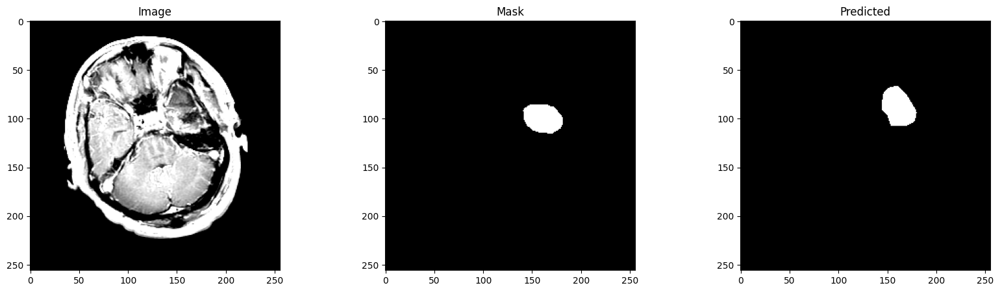

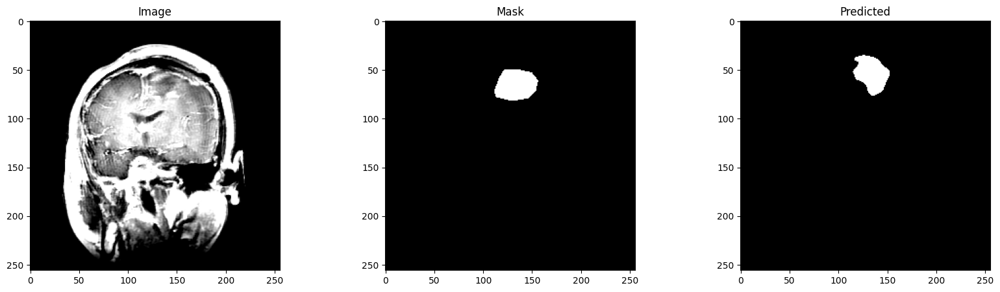

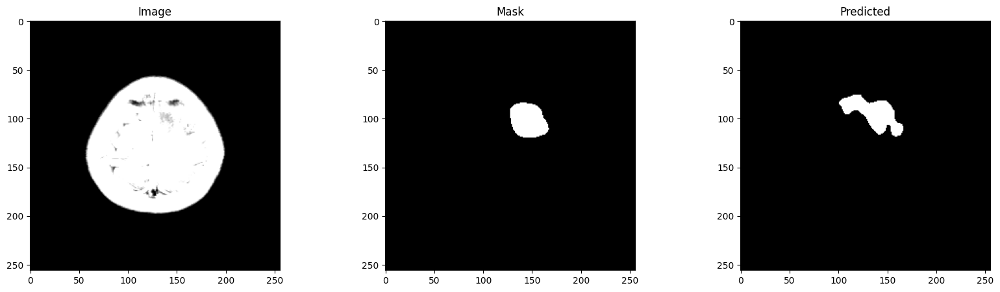

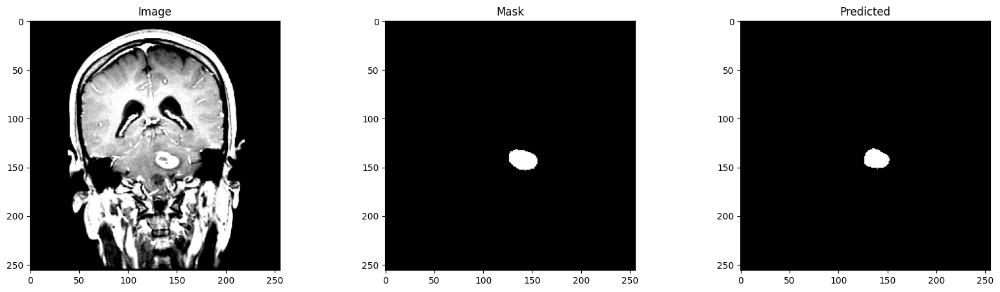

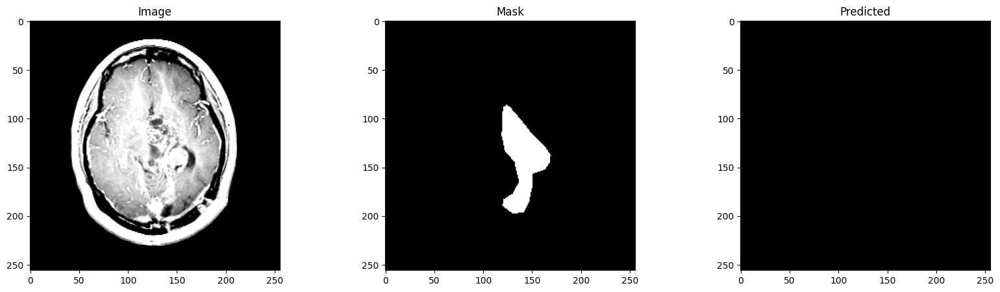

...

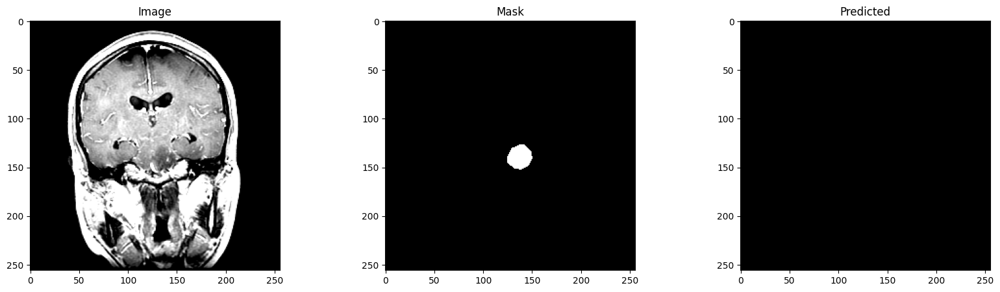

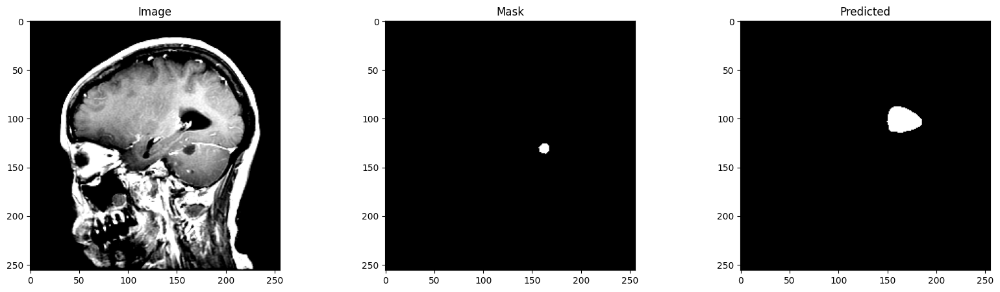

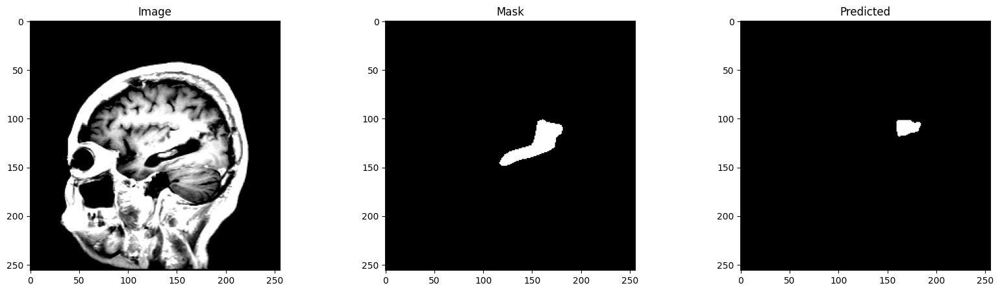

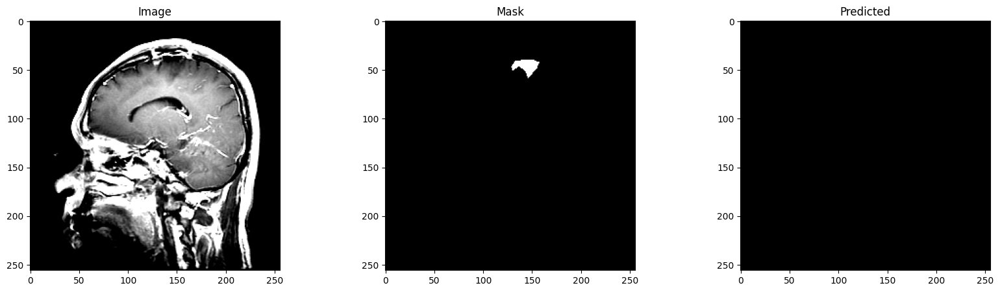

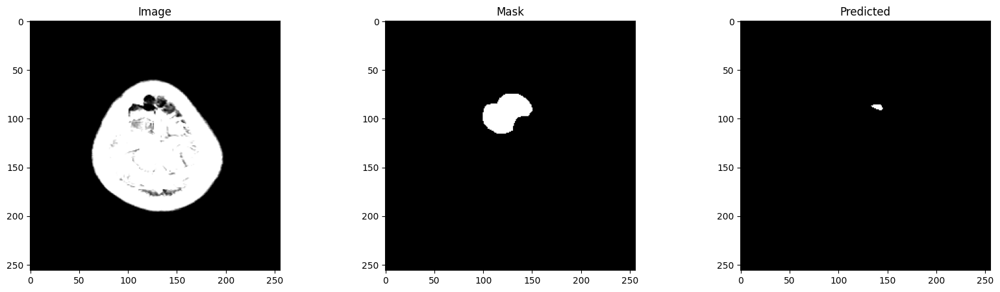

In [ ]:
for i in range(20):
  fig, arr = plt.subplots(1,3,figsize=(20,5))
  image_tensor = test700_images[i].squeeze(0)  # Now the shape is (3, 256, 256)
  image_np = image_tensor.permute(1, 2, 0).numpy()
  arr[0].imshow(image_np)
  arr[0].set_title('Image')
  arr[1].imshow(test700_masks[i],cmap='gray')
  arr[1].set_title('Mask')
  arr[2].imshow(pred_masks_tensors700[i].cpu(),cmap='gray')
  arr[2].set_title('Predicted')

In [ ]:
ground_truth_masks = []
for i in range(len(test700_images)):
  ground_truth_tensor = torch.from_numpy(test700_masks[i])
  ground_truth_tensor = ground_truth_tensor.to(pred_masks_tensors700[0])
  ground_truth_masks.append(ground_truth_tensor)

In [ ]:
DSC_ = DSC_avg()
dsc_value = DSC_(pred_masks_tensors700,ground_truth_masks)
print("result: ")
print(dsc_value)

result: 
0.5936926852230777


In [ ]:
target_masks_array = np.array(test1100_masks)
target_masks = target_masks_array.astype(bool)
pred_mask_array = np.array(pred_masks_tensors700)
pred_masks = pred_mask_array.astype(bool)

mAP = compute_mean_average_precision(pred_masks, target_masks)
print(f'mAP: {mAP:.4f}') #nincs prediction --> map 0

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0


KeyboardInterrupt: 

# **Train 900**

In [ ]:
model = torch.hub.load('mateuszbuda/brain-segmentation-pytorch', 'unet',
    in_channels=3, out_channels=1, init_features=32, pretrained=True)

Using cache found in /root/.cache/torch/hub/mateuszbuda_brain-segmentation-pytorch_master


In [ ]:
model900 = model

#for param in model900.encoder1.parameters():
#    param.requires_grad = False
#for param in model900.encoder2.parameters():
#    param.requires_grad = False
#for param in model900.encoder3.parameters():
#    param.requires_grad = False
#for param in model900.encoder4.parameters():
#    param.requires_grad = False

#criterion = nn.BCEWithLogitsLoss()
criterion = DiceLoss()
optimizer = optim.Adam(model900.parameters(), lr=0.001)

In [ ]:
dataset = CustomDataset(train900_images, train900_masks)
batch_size = 64
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

In [ ]:
# Training loop
num_epochs = 30  # Define number of epochs
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Ensure the model is on GPU if available
model900.to(device)  # Move the model to the GPU
model900.train()
for epoch in range(num_epochs):
    running_loss = 0.0
    for images, masks in dataloader:
        images, masks = images.to(device), masks.to(device)
        optimizer.zero_grad()  # Zero the gradients

        if images.shape[1] == 1:
           images = images.squeeze(1)

        masks = masks.permute(0, 3, 1, 2)
        outputs = model900(images)

        # Compute the loss
        loss = criterion(outputs, masks)
        # Backward pass and optimize
        loss.backward()
        optimizer.step()
        running_loss += loss.item() * images.size(0)

    epoch_loss = running_loss / len(dataloader.dataset)
    print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {epoch_loss:.4f}")

print("Training finished!")

<ipython-input-11-d7a005a2073e>:13: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  image_tensor = torch.tensor(image, dtype=torch.float32)


Epoch [1/30], Loss: 0.0751
Epoch [2/30], Loss: 0.0721
Epoch [3/30], Loss: 0.0695
Epoch [4/30], Loss: 0.0672
Epoch [5/30], Loss: 0.0608
Epoch [6/30], Loss: 0.0542
Epoch [7/30], Loss: 0.0551
Epoch [8/30], Loss: 0.0552
Epoch [9/30], Loss: 0.0566
Epoch [10/30], Loss: 0.0564
Epoch [11/30], Loss: 0.0520
Epoch [12/30], Loss: 0.0475
Epoch [13/30], Loss: 0.0483
Epoch [14/30], Loss: 0.0501
Epoch [15/30], Loss: 0.0507
Epoch [16/30], Loss: 0.0505
Epoch [17/30], Loss: 0.0488
Epoch [18/30], Loss: 0.0506
Epoch [19/30], Loss: 0.0483
Epoch [20/30], Loss: 0.0446
Epoch [21/30], Loss: 0.0412
Epoch [22/30], Loss: 0.0414
Epoch [23/30], Loss: 0.0406
Epoch [24/30], Loss: 0.0401
Epoch [25/30], Loss: 0.0390
Epoch [26/30], Loss: 0.0399
Epoch [27/30], Loss: 0.0403
Epoch [28/30], Loss: 0.0400
Epoch [29/30], Loss: 0.0383
Epoch [30/30], Loss: 0.0421
Training finished!


In [ ]:
pred_masks_array900 = []
pred_masks_tensors900 = []
model900.eval()

for input_image in test900_images:

  if torch.cuda.is_available():
      input_image = input_image.to('cuda')
      model = model900.to('cuda')

  with torch.no_grad():
      output = model900(input_image)

  pred_masks_tensors900.append(torch.round(output[0]).permute(1,2,0))
  numpy_array = torch.round(output[0]).cpu().numpy()
  array = numpy_array.copy()

    # Reshape the tensor if it has a single channel
  if array.ndim == 3 and array.shape[0] == 1:
      array = np.squeeze(array, axis=0)
  pred_masks_array900.append(array)

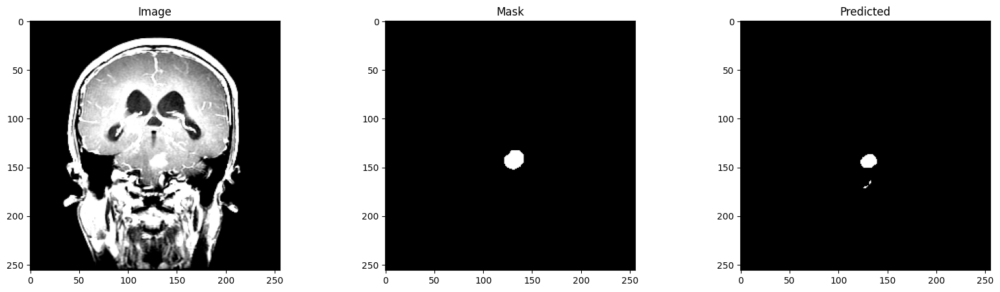

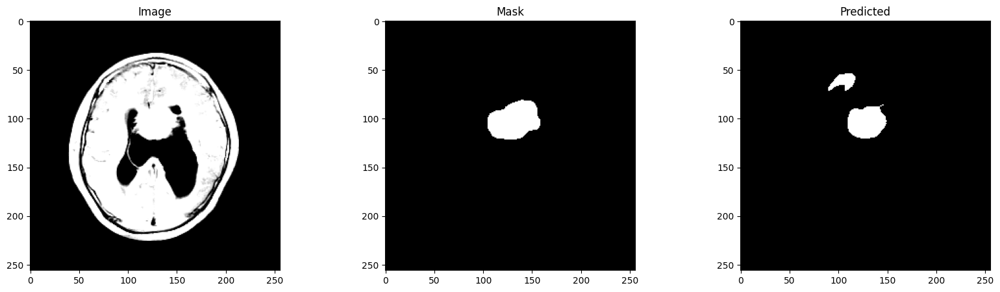

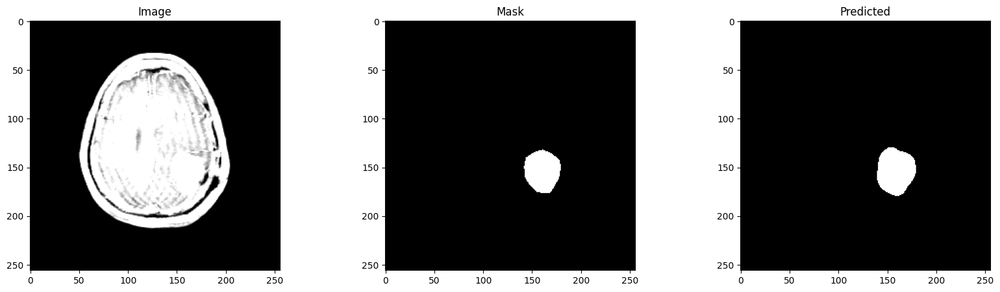

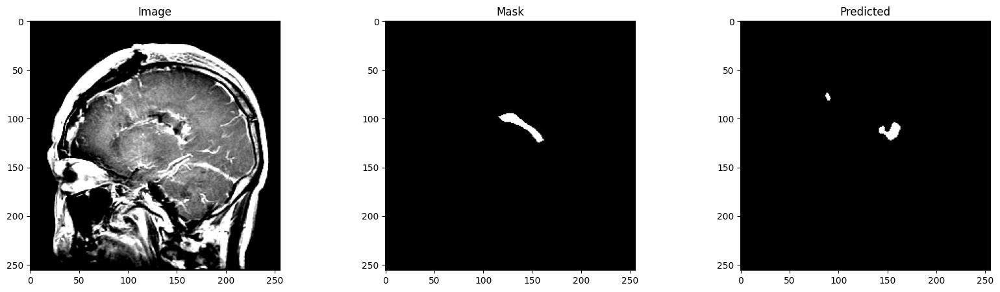

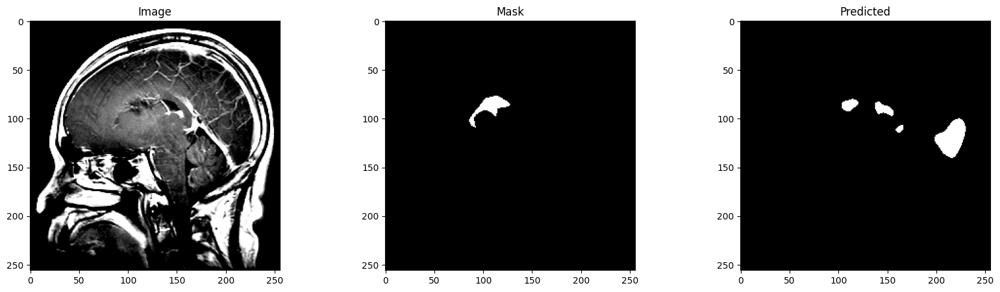

...

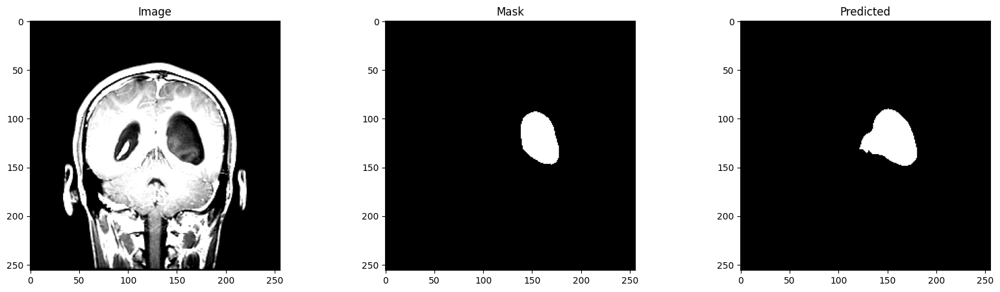

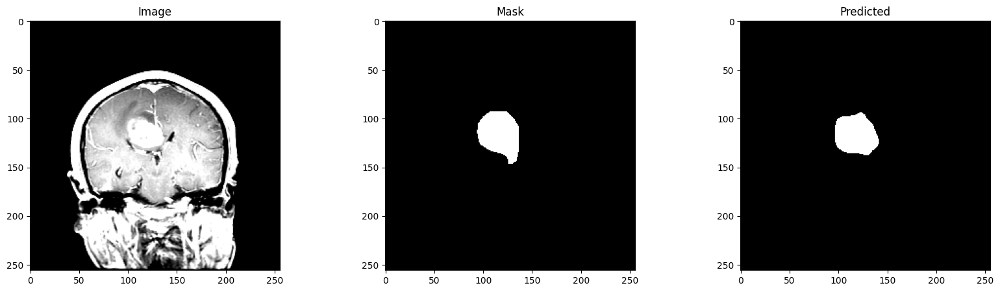

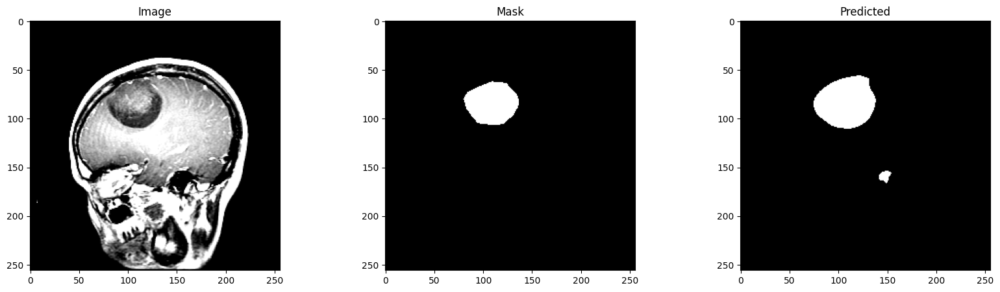

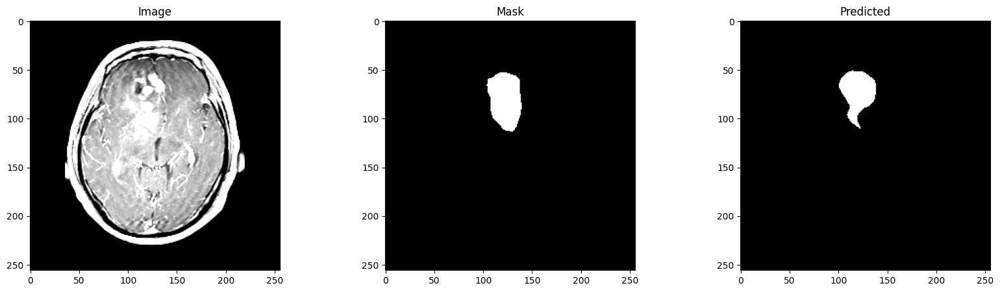

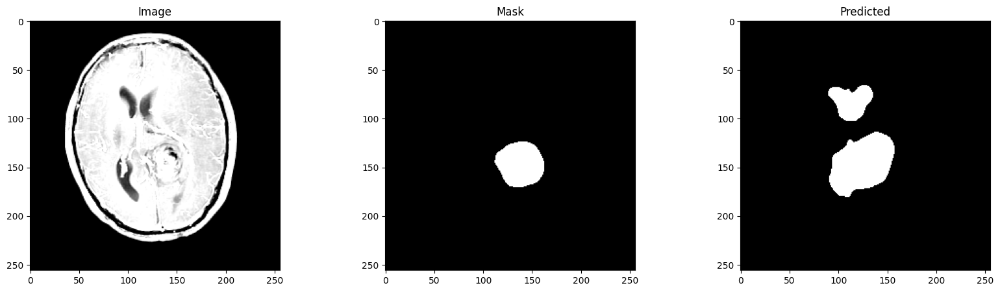

In [ ]:
for i in range(20):
  fig, arr = plt.subplots(1,3,figsize=(20,5))
  image_tensor = test900_images[i].squeeze(0)  # Now the shape is (3, 256, 256)
  image_np = image_tensor.permute(1, 2, 0).numpy()
  arr[0].imshow(image_np)
  arr[0].set_title('Image')
  arr[1].imshow(test900_masks[i],cmap='gray')
  arr[1].set_title('Mask')
  arr[2].imshow(pred_masks_tensors900[i].cpu(),cmap='gray')
  arr[2].set_title('Predicted')

In [ ]:
ground_truth_masks = []
for i in range(len(test900_images)):
  ground_truth_tensor = torch.from_numpy(test900_masks[i])
  ground_truth_tensor = ground_truth_tensor.to(pred_masks_tensors900[0])
  ground_truth_masks.append(ground_truth_tensor)

In [ ]:
DSC_ = DSC_avg()
dsc_value = DSC_(pred_masks_tensors900,ground_truth_masks)
print("result: ")
print(dsc_value)

result: 
0.6456250470745694


# **Train 1100**

In [ ]:
model = torch.hub.load('mateuszbuda/brain-segmentation-pytorch', 'unet',
    in_channels=3, out_channels=1, init_features=32, pretrained=True)

Using cache found in /root/.cache/torch/hub/mateuszbuda_brain-segmentation-pytorch_master


In [ ]:
model1100 = model

#for param in model1100.encoder1.parameters():
#    param.requires_grad = False
#for param in model1100.encoder2.parameters():
 #   param.requires_grad = False
#for param in model1100.encoder3.parameters():
#    param.requires_grad = False
#for param in model1100.encoder4.parameters():
#    param.requires_grad = False

#criterion = nn.BCEWithLogitsLoss()
criterion = DiceLoss()
optimizer = optim.Adam(model1100.parameters(), lr=0.001)

In [ ]:
dataset = CustomDataset(train1100_images, train1100_masks)
batch_size = 32
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

In [ ]:
# Training loop
num_epochs = 30  # Define number of epochs
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Ensure the model is on GPU if available
model1100.to(device)  # Move the model to the GPU
model1100.train()
for epoch in range(num_epochs):
    running_loss = 0.0
    for images, masks in dataloader:
        images, masks = images.to(device), masks.to(device)
        optimizer.zero_grad()  # Zero the gradients

        if images.shape[1] == 1:
           images = images.squeeze(1)

        masks = masks.permute(0, 3, 1, 2)
        outputs = model1100(images)

        # Compute the loss
        loss = criterion(outputs, masks)
        # Backward pass and optimize
        loss.backward()
        optimizer.step()
        running_loss += loss.item() * images.size(0)

    epoch_loss = running_loss / len(dataloader.dataset)
    print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {epoch_loss:.4f}")

print("Training finished!")

<ipython-input-11-d7a005a2073e>:13: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  image_tensor = torch.tensor(image, dtype=torch.float32)


Epoch [1/30], Loss: 0.0925
Epoch [2/30], Loss: 0.0801
Epoch [3/30], Loss: 0.0854
Epoch [4/30], Loss: 0.0766
Epoch [5/30], Loss: 0.0864
Epoch [6/30], Loss: 0.0790
Epoch [7/30], Loss: 0.0781
Epoch [8/30], Loss: 0.0767
Epoch [9/30], Loss: 0.0889
Epoch [10/30], Loss: 0.0803
Epoch [11/30], Loss: 0.0722
Epoch [12/30], Loss: 0.0608
Epoch [13/30], Loss: 0.0552
Epoch [14/30], Loss: 0.0499
Epoch [15/30], Loss: 0.0469
Epoch [16/30], Loss: 0.0455
Epoch [17/30], Loss: 0.0452
Epoch [18/30], Loss: 0.0436
Epoch [19/30], Loss: 0.0428
Epoch [20/30], Loss: 0.0421
Epoch [21/30], Loss: 0.0406
Epoch [22/30], Loss: 0.0405
Epoch [23/30], Loss: 0.0398
Epoch [24/30], Loss: 0.0410
Epoch [25/30], Loss: 0.0408
Epoch [26/30], Loss: 0.0389
Epoch [27/30], Loss: 0.0382
Epoch [28/30], Loss: 0.0390
Epoch [29/30], Loss: 0.0931
Epoch [30/30], Loss: 0.1471
Training finished!


In [ ]:
pred_masks_array1100 = []
pred_masks_tensors1100 = []
model1100.eval()

for input_image in test1100_images:

  if torch.cuda.is_available():
      input_image = input_image.to('cuda')
      model = model1100.to('cuda')

  with torch.no_grad():
      output = model1100(input_image)

  pred_masks_tensors1100.append(torch.round(output[0]).permute(1,2,0))
  numpy_array = torch.round(output[0]).cpu().numpy()
  array = numpy_array.copy()

    # Reshape the tensor if it has a single channel
  if array.ndim == 3 and array.shape[0] == 1:
      array = np.squeeze(array, axis=0)
  pred_masks_array1100.append(array)

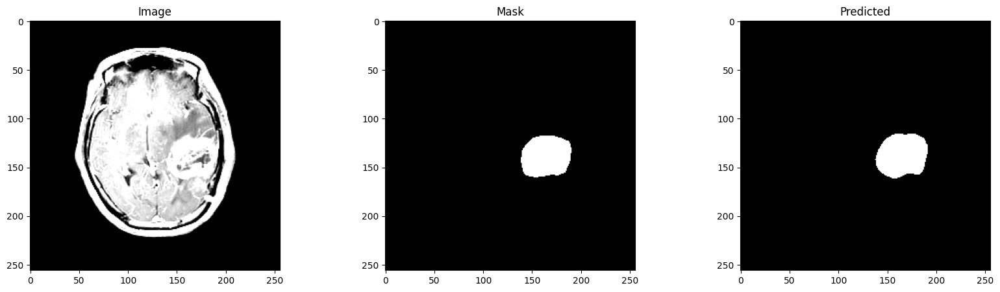

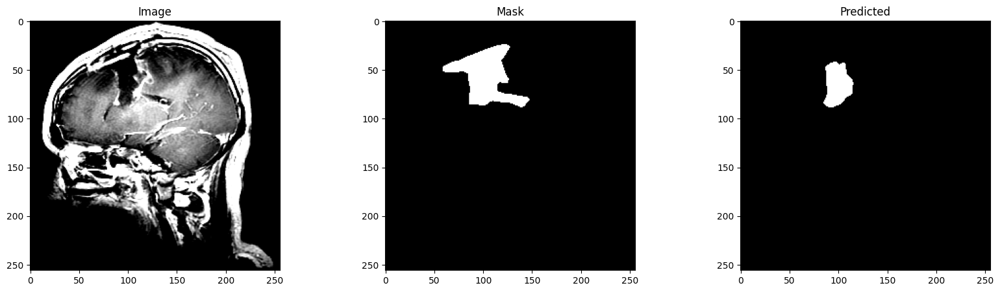

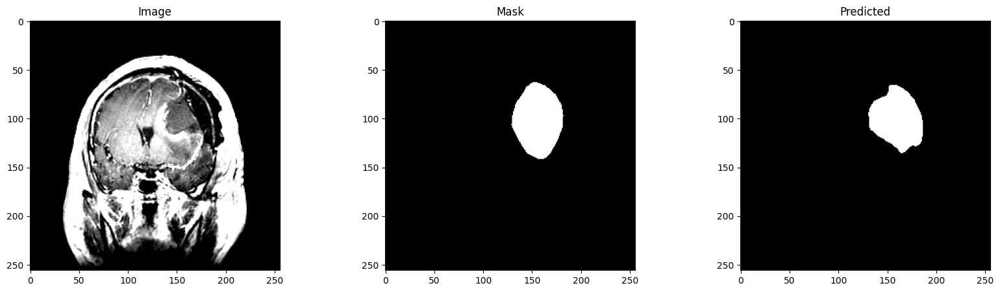

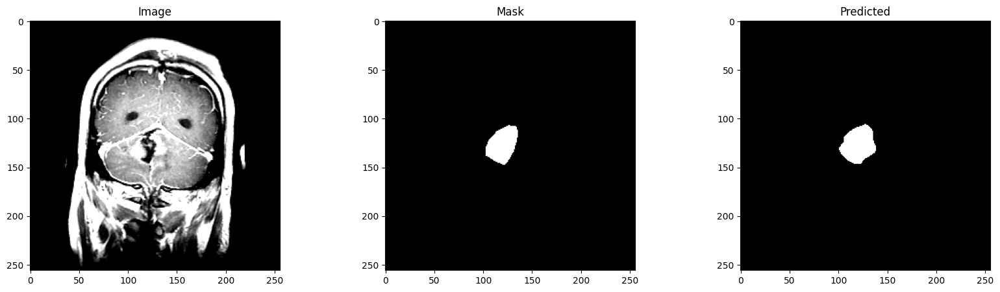

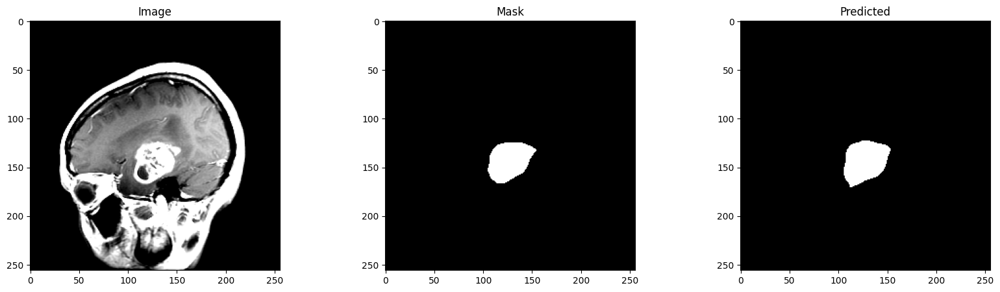

...

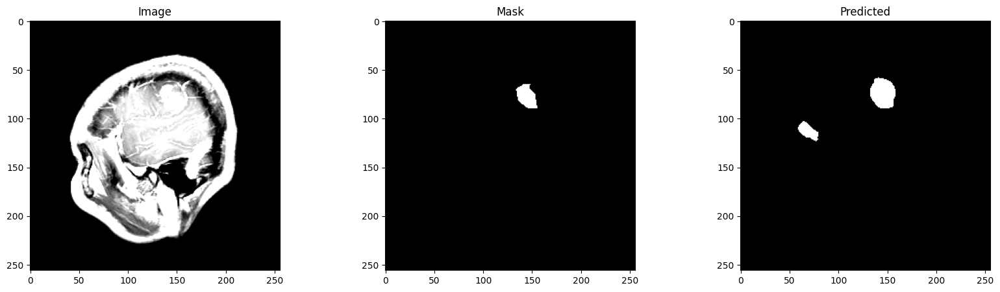

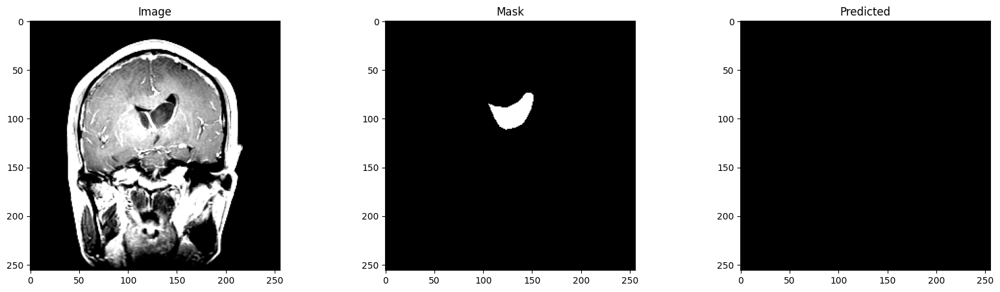

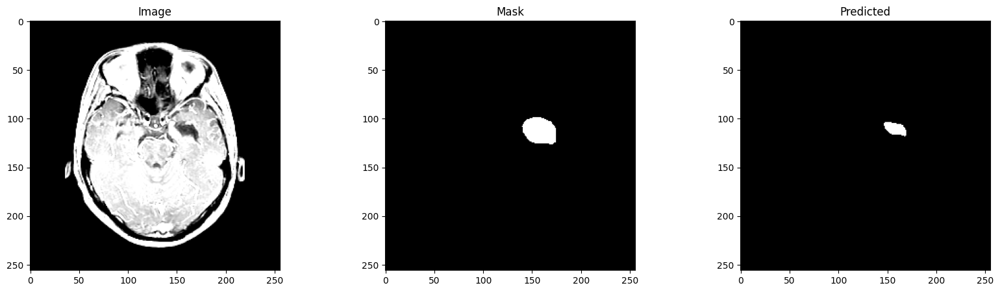

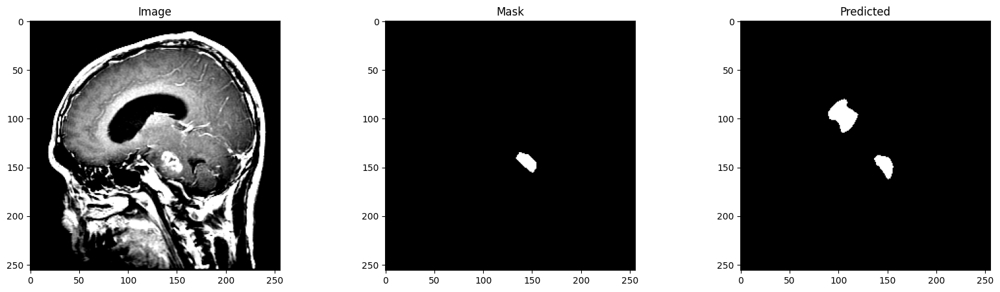

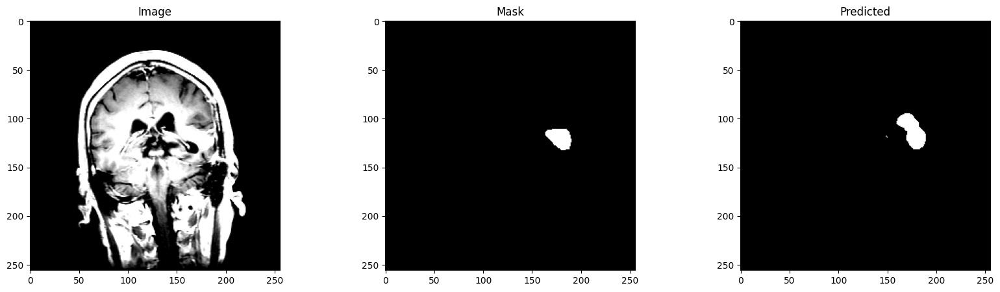

In [ ]:
for i in range(20):
  fig, arr = plt.subplots(1,3,figsize=(20,5))
  image_tensor = test1100_images[i].squeeze(0)  # Now the shape is (3, 256, 256)
  image_np = image_tensor.permute(1, 2, 0).numpy()
  arr[0].imshow(image_np)
  arr[0].set_title('Image')
  arr[1].imshow(test1100_masks[i],cmap='gray')
  arr[1].set_title('Mask')
  arr[2].imshow(pred_masks_tensors1100[i].cpu(),cmap='gray')
  arr[2].set_title('Predicted')

In [ ]:
ground_truth_masks = []
for i in range(len(test1100_images)):
  ground_truth_tensor = torch.from_numpy(test1100_masks[i])
  ground_truth_tensor = ground_truth_tensor.to(pred_masks_tensors1100[0])
  ground_truth_masks.append(ground_truth_tensor)

In [ ]:
DSC_ = DSC_avg()
dsc_value = DSC_(pred_masks_tensors1100,ground_truth_masks)
print("result: ")
print(dsc_value)

result: 
0.5193597064896321


# **Train 1300**

In [ ]:
model = torch.hub.load('mateuszbuda/brain-segmentation-pytorch', 'unet',
    in_channels=3, out_channels=1, init_features=32, pretrained=True)

/usr/local/lib/python3.10/dist-packages/torch/hub.py:293: UserWarning: You are about to download and run code from an untrusted repository. In a future release, this won't be allowed. To add the repository to your trusted list, change the command to {calling_fn}(..., trust_repo=False) and a command prompt will appear asking for an explicit confirmation of trust, or load(..., trust_repo=True), which will assume that the prompt is to be answered with 'yes'. You can also use load(..., trust_repo='check') which will only prompt for confirmation if the repo is not already trusted. This will eventually be the default behaviour
  warnings.warn(
Downloading: "https://github.com/mateuszbuda/brain-segmentation-pytorch/zipball/master" to /root/.cache/torch/hub/master.zip
Downloading: "https://github.com/mateuszbuda/brain-segmentation-pytorch/releases/download/v1.0/unet-e012d006.pt" to /root/.cache/torch/hub/checkpoints/unet-e012d006.pt


In [ ]:
model1300 = model

#for param in model1300.encoder1.parameters():
#    param.requires_grad = False
#for param in model1300.encoder2.parameters():
#    param.requires_grad = False
#for param in model1300.encoder3.parameters():
#    param.requires_grad = False
#for param in model1300.encoder4.parameters():
#    param.requires_grad = False

#criterion = nn.BCEWithLogitsLoss()
criterion = DiceLoss()
optimizer = optim.Adam(model1300.parameters(), lr=0.001)

In [ ]:
dataset = CustomDataset(train1300_images, train1300_masks)
batch_size = 32
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

In [ ]:
# Training loop
num_epochs = 30  # Define number of epochs
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # Ensure the model is on GPU if available
model1300.to(device)  # Move the model to the GPU
model1300.train()
for epoch in range(num_epochs):
    running_loss = 0.0
    for images, masks in dataloader:
        images, masks = images.to(device), masks.to(device)
        optimizer.zero_grad()  # Zero the gradients

        if images.shape[1] == 1:
           images = images.squeeze(1)

        masks = masks.permute(0, 3, 1, 2)
        outputs = model1300(images)

        # Compute the loss
        loss = criterion(outputs, masks)
        # Backward pass and optimize
        loss.backward()
        optimizer.step()
        running_loss += loss.item() * images.size(0)

    epoch_loss = running_loss / len(dataloader.dataset)
    print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {epoch_loss:.4f}")

print("Training finished!")

<ipython-input-12-d7a005a2073e>:13: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  image_tensor = torch.tensor(image, dtype=torch.float32)
/usr/local/lib/python3.10/dist-packages/torch/autograd/graph.py:744: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return Variable._execution_engine.run_backward(  # Calls into the C++ engine to run the backward pass


Epoch [1/30], Loss: 0.5322
Epoch [2/30], Loss: 0.4006
Epoch [3/30], Loss: 0.3545
Epoch [4/30], Loss: 0.3385
Epoch [5/30], Loss: 0.3118
Epoch [6/30], Loss: 0.2963
Epoch [7/30], Loss: 0.2920
Epoch [8/30], Loss: 0.2668
Epoch [9/30], Loss: 0.2548
Epoch [10/30], Loss: 0.2438
Epoch [11/30], Loss: 0.2263
Epoch [12/30], Loss: 0.2224
Epoch [13/30], Loss: 0.2219
Epoch [14/30], Loss: 0.2156
Epoch [15/30], Loss: 0.2066
Epoch [16/30], Loss: 0.2058
Epoch [17/30], Loss: 0.1923
Epoch [18/30], Loss: 0.1994
Epoch [19/30], Loss: 0.1820
Epoch [20/30], Loss: 0.1699
Epoch [21/30], Loss: 0.1629
Epoch [22/30], Loss: 0.1564
Epoch [23/30], Loss: 0.1531
Epoch [24/30], Loss: 0.1506
Epoch [25/30], Loss: 0.1425
Epoch [26/30], Loss: 0.1667
Epoch [27/30], Loss: 0.1622
Epoch [28/30], Loss: 0.1445
Epoch [29/30], Loss: 0.1360
Epoch [30/30], Loss: 0.1291
Training finished!


In [ ]:
pred_masks_array1300 = []
pred_masks_tensors1300 = []
model1300.eval()

for input_image in test1300_images:

  if torch.cuda.is_available():
      input_image = input_image.to('cuda')
      model = model1300.to('cuda')

  with torch.no_grad():
      output = model1300(input_image)

  pred_masks_tensors1300.append(torch.round(output[0]).permute(1,2,0))
  numpy_array = torch.round(output[0]).cpu().numpy()
  array = numpy_array.copy()

    # Reshape the tensor if it has a single channel
  if array.ndim == 3 and array.shape[0] == 1:
      array = np.squeeze(array, axis=0)
  pred_masks_array1300.append(array)

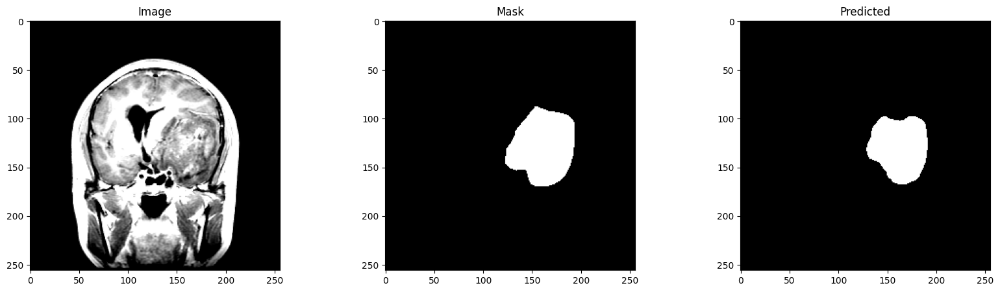

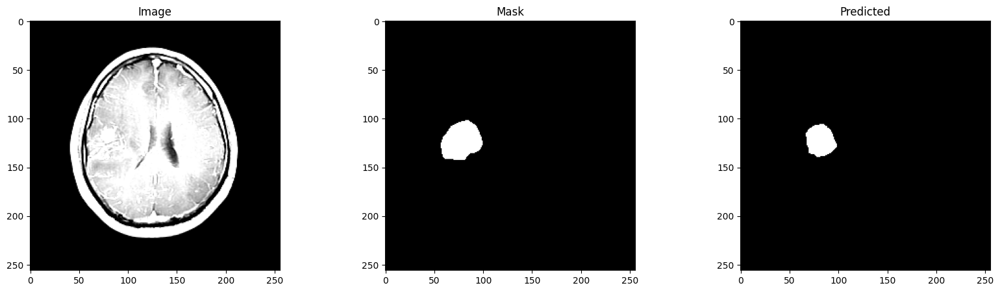

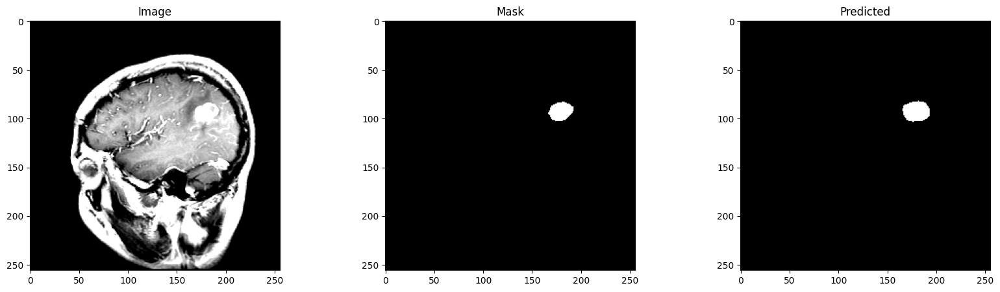

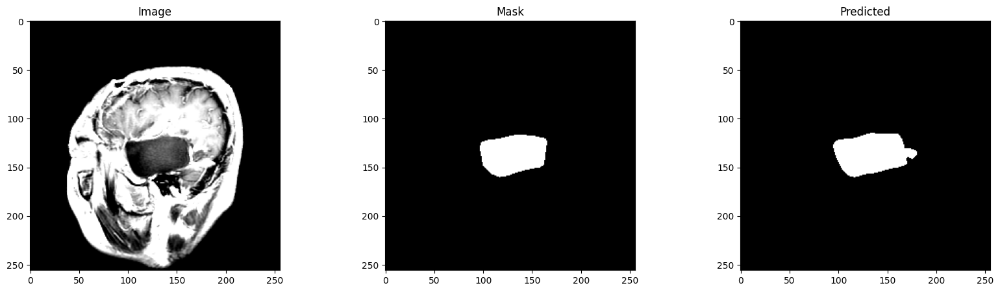

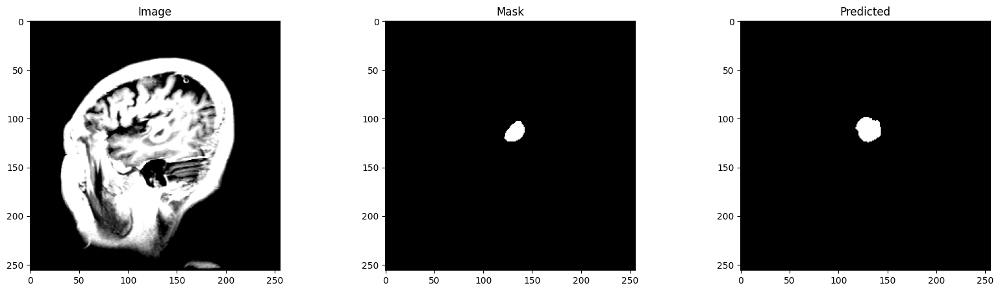

...

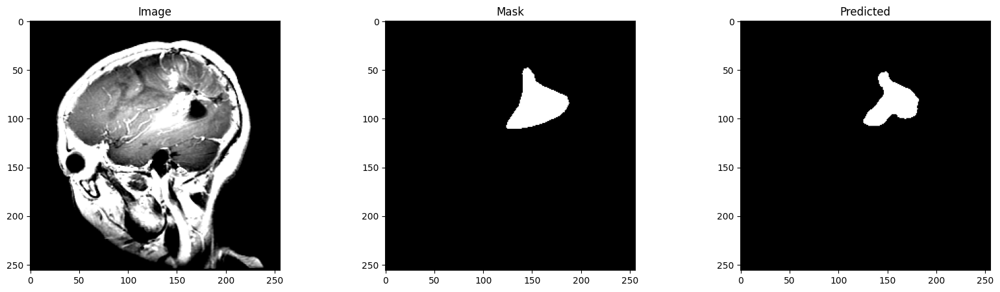

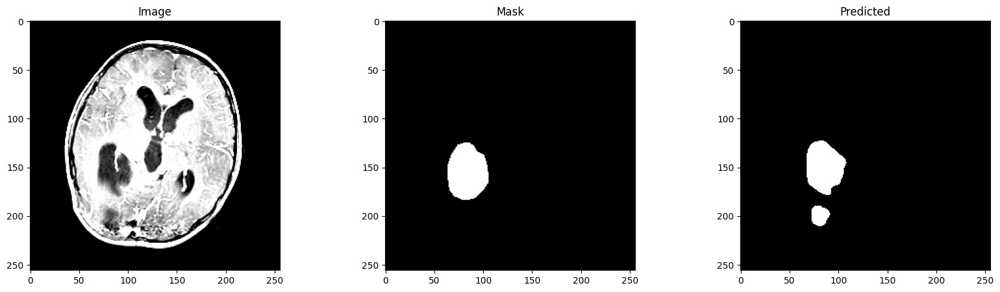

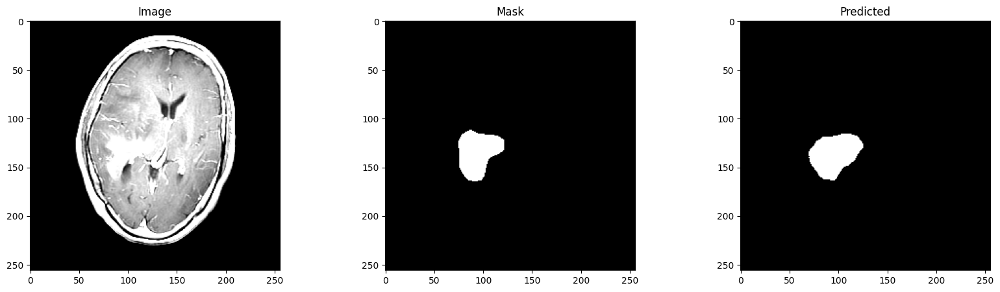

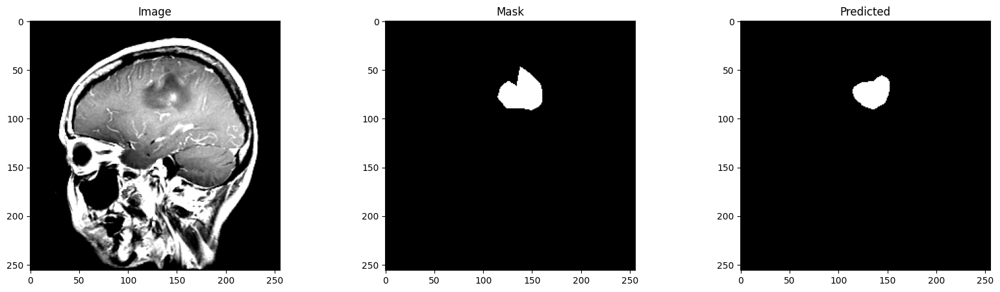

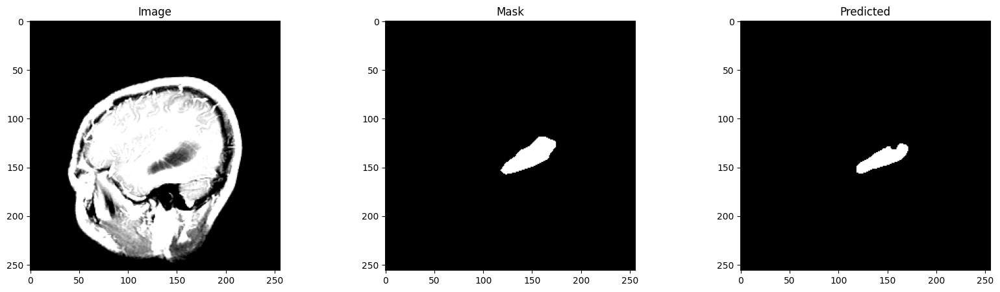

In [ ]:
for i in range(20):
  fig, arr = plt.subplots(1,3,figsize=(20,5))
  image_tensor = test1300_images[i].squeeze(0)  # Now the shape is (3, 256, 256)
  image_np = image_tensor.permute(1, 2, 0).numpy()
  arr[0].imshow(image_np)
  arr[0].set_title('Image')
  arr[1].imshow(test1300_masks[i],cmap='gray')
  arr[1].set_title('Mask')
  arr[2].imshow(pred_masks_tensors1300[i].cpu(),cmap='gray')
  arr[2].set_title('Predicted')

In [ ]:
ground_truth_masks = []
for i in range(len(test1300_images)):
  ground_truth_tensor = torch.from_numpy(test1300_masks[i])
  ground_truth_tensor = ground_truth_tensor.to(pred_masks_tensors1300[0])
  ground_truth_masks.append(ground_truth_tensor)

In [ ]:
DSC_ = DSC_avg()
dsc_value = DSC_(pred_masks_tensors1300,ground_truth_masks)
print("result: ")
print(dsc_value)

result: 
0.6730355311754264
